

# IBM Applied Data Science Capstone Report

## Evaluate metropolitan Adelaide hotel locations by net gaming revenue, population density and traffic volume

[Peter Buchanan](https://www.linkedin.com/in/buchananpeter/) - April 2020

<img src="images/shutterstock_262869080-1.jpg" width="60%" align="center"/>


### Table of Contents
* [4. Data Preparation](#4.-Data-Preparation)
    * [4.1. Download and Unzip Files](#4.1.-Download-and-Unzip-Files)
    * [4.2. Read files into Dataframes](#4.2.-Read-files-into-Dataframes)
    * [4.3. Hotel Dataset: Clean](#4.3.-Hotel-Dataset:-Clean)
    * [4.4. Hotel Dataset: Update GoogleAPI Geocoding](#4.4.-Hotel-Dataset:-Update-GoogleAPI-Geocoding)
    * [4.5. Hotel Dataset: Merge Australian Bureau of Statistics (ABS) and Australian Tax Office (ATO)](#4.5.-Hotel-Dataset:-Merge-Australian-Bureau-of-Statistics-(ABS)-and-Australian-Tax-Office-(ATO))
    * [4.6. Gaming Revenue Dataset: Clean](#4.6.-Gaming-Revenue-Dataset:-Clean)
    * [4.7. Top Net Gaming Revenue Cities Dataset: Clean](#4.7.-Top-Net-Gaming-Revenue-Cities-Dataset:-Clean)
    * [4.8. Hotels in Top Net Gaming Revenue Cities Dataset](#4.8.-Hotels-in-Top-Net-Gaming-Revenue-Cities-Dataset)    
    * [4.9. Shopping Malls Within Top Net Gaming Revenue Cities Dataset: Clean](#4.9.-Shopping-Malls-Within-Top-Net-Gaming-Revenue-Cities-Dataset:-Clean)
    * [4.10. BeautifulSoup: Top Net Gaming Revenue LGA Cities Census Dataset: Clean](#4.10.-BeautifulSoup:-Top-Net-Gaming-Revenue-LGA-Cities-Census-Dataset:-Clean)
    * [4.11. FourSquare Dataset: Venue Categories Clean](#4.11.-FourSquare-Dataset:-Venue-Categories-Clean)
    * [4.12. FourSquare Dataset: Venue Explore: All Categories for Top NGR Cities ( HierarchyLevel 1 to 5 )](#4.12.-FourSquare-Dataset:-Venue-Explore:-All-Categories-for-Top-NGR-Cities-(-HierarchyLevel-1-to-5-))
    * [4.13. Pickle Pandas Dataframes](#4.13.-Pickle-Pandas-Dataframes)    
* [5. Analysis and Machine Learning](#5.-Analysis-and-Machine-Learning)
    * [5.1 Exploratory Data Analysis (EDA)](#5.1-Exploratory-Data-Analysis-(EDA))
    * [5.2 Choropleth: Ranking of Local Government Area/Group by Average NGR per machine](#5.2-Choropleth:-Ranking-of-Local-Government-Area/Group-by-Average-NGR-per-machine)
    * [5.3 Barchart: Average Net Gaming Revenue per machine (2018/19) by Local Government Area](#5.3-Barchart:-Average-Net-Gaming-Revenue-per-machine-(2018/19)-by-Local-Government-Area)
    * [5.4 Barchart: Average Net Gaming Revenue per venue (2018/19) by Local Government Area](#5.4-Barchart:-Average-Net-Gaming-Revenue-per-venue-(2018/19)-by-Local-Government-Area)
    * [5.5 Barchart: Population by City in Local Government Area (Campbelltown / Tea Tree Gully)](#5.5-Barchart:-Population-by-City-in-Local-Government-Area-(Campbelltown-/-Tea-Tree-Gully))
    * [5.6 Choropleth: City, Hotel, Shopping Mall, Foursquare search radius and Traffic Volume](#5.5-Choropleth:-City,-Hotel,-Shopping-Mall,-Foursquare-search-radius-and-Traffic-Volume)
    * [5.7 K-Means Cluster Analysis Of Cities by Foursquare Category](#5.6-K-Means-Cluster-Analysis-Of-Cities-by-Foursquare-Category)
    * [5.8 KElbowVisualizer: The Optimal K-Cluster with Elbow Method](#5.7-KElbowVisualizer:-The-Optimal-K-Cluster-with-Elbow-Method)
    * [5.9 Top Ten Most Common Venues by City](#5.8-Top-Ten-Most-Common-Venues-by-City)
    * [5.10 Choropleth: Visualize Clusters by City](#5.9-Choropleth:-Visualize-Clusters-by-City)
    * [5.11 Examining distributional characteristics of clusters](#5.10-Examining-distributional-characteristics-of-clusters)    
    * [5.12 Cluster 0: Quiet Suburban](#5.11-Cluster-0:-Quiet-Suburban)
    * [5.13 Cluster 1: Rural](#5.12-Cluster-1:-Rural)
    * [5.14 Cluster 2: Recreation Park](#5.13-Cluster-2:-Recreation-Park)
    * [5.15 Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)](#5.14-Cluster-3:-Busy-Area-(Shopping-Malls,-Densely-Populated,-High-Traffic-Volume))
    * [5.16 Cluster 4: Recreational Area (Golfcourse, Gyms, Parks)](#5.15-Cluster-4:-Recreational-Area-(Golfcourse,-Gyms,-Parks))


## 4. Data Preparation

<div class="alert alert-block alert-success">
<b>Import: </b>Search for named modules, and bind name to local scope
</div>

In [1]:

# increase Jupyter cell width
from IPython.core.display import display, HTML
display(HTML("<style>.container {width:75% !important;}</style>"))
from IPython.display import clear_output

# add logging
import logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

import warnings
warnings.filterwarnings('ignore')

import os
os.environ['NUMEXPR_MAX_THREADS'] = '16'
os.environ['NUMEXPR_NUM_THREADS'] = '8'
import numexpr as ne


# data manipulation and analysis
from flatten_json import flatten
import pandas as pd
from pandas.io.json import json_normalize
pd.set_option("display.width", 201)
pd.set_option("display.max_rows", 1001)
pd.set_option("display.max_columns", 1001)
pd.set_option('max_colwidth', 120)

# Import libraries
import re
import sys
import time
from time import sleep
import path
from pathlib import Path
from io import BytesIO
from zipfile import ZipFile
import pprint
import pickle

# HTTP methods
import requests
import json
from bs4 import BeautifulSoup

# mathematical
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.features import RadViz
from yellowbrick.datasets import load_occupancy
import numpy as np

# plotting library
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.font_manager

from geopy import OpenCage
import folium
from folium import plugins
from folium.features import GeoJson, GeoJsonTooltip, GeoJsonPopup
import branca
import geopandas

# matplotlib plots will be stored in the notebook document
%matplotlib inline


<div class="alert alert-block alert-success">
<b>Constants: </b>Declare and assign value to a constant
</div>

In [2]:

# credentials stored in private config file
with open('config.json') as config_file:
    config = json.load(config_file)

# local working folder
DATA_FOLDER = 'data/'
                
# Google Maps API
GEOCODE_BASE_URL= 'https://maps.googleapis.com/maps/api/geocode/json'
GEOCODE_PLACE_URL = 'https://maps.googleapis.com/maps/api/place/textsearch/json'
GEOCODE_NEARBY_URL = 'https://maps.googleapis.com/maps/api/place/nearbysearch/json'
GEOCODE_API_KEY = config['GEOCODE_API_KEY']
GEOCODE_REGION = 'South Australia'
GEOCODE_REGION_SHORT = 'SA'
GEOCODE_COUNTRY = 'Australia'

# Foursquare API
FOURSQUARE_CLIENT_ID = config['CLIENT_ID']
FOURSQUARE_CLIENT_SECRET = config['CLIENT_SECRET']
FOURSQUARE_VERSION = '20200101' 
FOURSQUARE_LIMIT = 100
FOURSQUARE_SEARCH_RADIUS = 5000

#Foursquare API
FOURSQUARE_CATEGORY_URL = 'https://api.foursquare.com/v2/venues/categories?client_id={}&client_secret={}&v={}'
FOURSQUARE_EXPLORE_URL = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}'
FOURSQUARE_SEARCH_URL = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&ll={},{}&v={}&radius={}&query={}&categoryId={}&limit={}'

# South Australian Government, Data Directory
GOV_LIC_LICENCE_URL = 'https://data.sa.gov.au/data/dataset/cf466291-8740-4b54-ae11-8c98c347f201/resource/a15314ed-891d-4e14-8c1c-bf080894e9d9/download/lglicences20190819.xlsx'
GOV_LIC_LICENCE_FILE = DATA_FOLDER + 'GOV_2019_LIC_LICENCE.xlsx'

GOV_CITY_SHAPEFILE_URL = 'http://www.dptiapps.com.au/dataportal/Suburbs_shp.zip'
GOV_CITY_SHAPEFILE_FILE = DATA_FOLDER + 'Suburbs_GDA2020.shp'

GOV_TRAFFIC_SHAPEFILE_URL = 'http://www.dptiapps.com.au/dataportal/TrafficVolumeEstimates_shp.zip'
GOV_TRAFFIC_SHAPEFILE_FILE = DATA_FOLDER + 'TrafficVolumeEstimates_GDA2020.shp'

# Australian Bureau of Statistics, Australian Government
ABS_CITY_URL = 'https://www.abs.gov.au/ausstats/subscriber.nsf/log?openagent&1270055003_ssc_2016_aust_csv.zip&1270.0.55.003&Data%20Cubes&42CEBC5514202AFDCA25802C00142C05&0&July%202016&13.09.2016&Previous'
ABS_CITY_FILE = DATA_FOLDER + 'SSC_2016_AUST.csv'

ABS_LGA_NAME_URL = 'https://www.abs.gov.au/AUSSTATS/subscriber.nsf/log?openagent&1270055003_lga_2019_sa_csv.zip&1270.0.55.003&Data%20Cubes&BF5B81B93177FA82CA25844700263008&0&July%202019&31.07.2019&Latest'
ABS_LGA_NAME_FILE = DATA_FOLDER + 'LGA_2019_SA.csv'

ABS_LGA_SHAPEFILE_URL = 'https://www.abs.gov.au/AUSSTATS/subscriber.nsf/log?openagent&1270055003_lga_2019_aust_shp.zip&1270.0.55.003&Data%20Cubes&7797077B796AD26ACA25844700263135&0&July%202019&31.07.2019&Latest'
ABS_LGA_SHAPEFILE_FILE = DATA_FOLDER + 'LGA_2019_AUST.shp'

ABS_CENSUS_QUICKSTATS_URL = 'https://quickstats.censusdata.abs.gov.au/census_services/getproduct/census/2016/quickstat/SSC{}?opendocument'

# Australian Taxation Office Taxation Statistics
ATO_INCOME_URL = 'https://data.gov.au/data/dataset/540e3eac-f2df-48d1-9bc0-fbe8dfec641f/resource/bfa7ef04-e9f2-46ff-a959-84f005dfd17b/download/ts17snapshot07stateindividualsstatepostcodeoccupationstats.xlsx'
ATO_INCOME_FILE = DATA_FOLDER + 'ATO_2018_INCOME.xlsx'

# The South Australian Centre for Economic Studies (SACES)
SACES_GAMBLING_URL = 'http://www.adelaide.edu.au/saces/system/files/media/documents/2019-10/gambling-database-v13.0.xlsx'
SACES_GAMBLING_FILE = DATA_FOLDER + 'SACES_2019_NGR.xlsx'



### 4.1. Download and Unzip Files
<b>South Australian Government Data Directory (Data.SA)</b>
<ul>
<li><p><em>Liquor and Gaming Licences</em></p>A data set containing publically accessible licence details under Liquor and Gaming legislations. This information is provided from Consumer and Business Services<br>
  For more info see:<a href="https://data.sa.gov.au/data/dataset/liquor-gaming-licences">Liquor and Gaming Licences</a><br><br></li>
    
<li><p><em>City and Traffic Volume ESRI Shapefile (.shp)</em></p>A shapefile stores non-topological geometry and attribute information for the spatial features in a data set. The geometry for a feature is stored as a shape comprising a set of vector coordinates</li>
</ul>

<b>Australian Bureau of Statistics (ABS)</b>
<ul>
<li><p><em>State Suburbs (SSC)</em></p>Are an ABS approximation of localities gazetted by the Geographical Place Name authority in each State and Territory<br>
  Gazetted Localities are the officially recognised boundaries of suburbs (in cities and larger towns) and localities (outside cities and larger towns)<br>
    For more info see:<a href="https://www.abs.gov.au/ausstats/abs@.nsf/Lookup/by%20Subject/1270.0.55.003~July%202016~Main%20Features~State%20Suburbs%20(SSC)~9">Australian Statistical Geography Standard (ASGS)</a><br><br></li>
    
<li><p><em>Local Government Areas (LGAs)</em></p>The Australian Statistical Geography Standard (ASGS) Local Government Areas (LGAs) are an ABS approximation of officially gazetted Local Government Areas as defined by each State and Territory Local Government Department<br><br></li>
    
<li><p><em>Local Government Areas ESRI Shapefile (.shp)</em></p>A shapefile stores non-topological geometry and attribute information for the spatial features in a data set. The geometry for a feature is stored as a shape comprising a set of vector coordinates<br><br></li>

<li><p><em>Census Data QuickStats</em></p>QuickStats makes high level, at a glance Census data available for most areas, from small areas to state, territory and Australia level.</li>
</ul>

<b>Australian Tax Office (ATO)</b>
<ul>
<li><p><em>Taxation Statistics</em></p>An overview of the income and tax status of Australian individuals, companies, partnerships, trusts and funds for 2016-17<br>
  For more info see:<a href="https://www.ato.gov.au/About-ATO/Research-and-statistics/In-detail/Taxation-statistics/Taxation-statistics-2016-17/">Taxation statistics</a><br></li>
</ul>

<b>The South Australian Centre for Economic Studies (SACES)</b>
<ul>
<li><p><em>Gambling Database</em></p>The South Australian Centre for Economic Studies has developed a Gambling Database that provides regional level data on gaming machine activity in South Australian licensed venues<br>
  For more info see:<a href="https://www.adelaide.edu.au/saces/publications-research-resources/gambling#gambling-database-gaming-machines">Gambling Database</a><br></li>
</ul>

<div class="alert alert-block alert-success">
<b>Note:</b>
<ul>
<li><p><em>Mesh Blocks</em></p>Are the smallest geographical area defined by the Australian Bureau of Statistics (ABS) and form the building blocks for the larger regions of the Australian Statistical Geography Standard (ASGS).<br> All other statistical areas or regions are built up from or, approximated by whole Mesh Blocks<br>Where possible, one Mesh Block will have a dwelling count of between 30 and 60<br><br></li>
</ul>
</div>

In [3]:
try:
    
    # delete all files except pickle, in data folder
    fileList = os.listdir(DATA_FOLDER)
    for fileName in fileList:
        f = os.path.join(DATA_FOLDER, fileName)
        if (Path(f).suffix).lower() != '.pkl':
            os.remove(f)
    
    # Download Excel: GOV_2019_LIC_LICENCE.xlsx
    content = requests.get(GOV_LIC_LICENCE_URL)
    with open(GOV_LIC_LICENCE_FILE, 'wb') as f:
        f.write(content.content)

    # Download and unzip: Suburbs_GDA2020.shp
    content = requests.get(GOV_CITY_SHAPEFILE_URL)
    zf = ZipFile(BytesIO(content.content)).extractall(DATA_FOLDER)

    # Download and unzip: TrafficVolumeEstimates_GDA2020.shp
    content = requests.get(GOV_TRAFFIC_SHAPEFILE_URL)
    zf = ZipFile(BytesIO(content.content)).extractall(DATA_FOLDER)
        
    # Download and unzip: SSC_2016_AUST.csv
    content = requests.get(ABS_CITY_URL)
    zf = ZipFile(BytesIO(content.content)).extractall(DATA_FOLDER)

    # Download and unzip: LGA_2019_SA.csv
    content = requests.get(ABS_LGA_NAME_URL)
    zf = ZipFile(BytesIO(content.content)).extractall(DATA_FOLDER)

    # Download and unzip: LGA_2019_AUST.shp
    content = requests.get(ABS_LGA_SHAPEFILE_URL)
    zf = ZipFile(BytesIO(content.content)).extractall(DATA_FOLDER)

    # Download Excel: ATO_2018_INCOME.xlsx
    content = requests.get(ATO_INCOME_URL)
    with open(ATO_INCOME_FILE, 'wb') as f:
        f.write(content.content)
        
    # Download Excel: SACES_2019_NGR.xlsx
    content = requests.get(SACES_GAMBLING_URL)
    with open(SACES_GAMBLING_FILE, 'wb') as f:
        f.write(content.content)
                                
except Exception:
    logger.error('Dataset: Download files: ', exc_info=True)
    
else:
    logger.info('Dataset: Download files: OK')

INFO:__main__:Dataset: Download files: OK


### 4.2. Read files into Dataframes

In [4]:
try:
        
    # Import to Datafrome: hotel_df
    hotel_df = pd.read_excel(GOV_LIC_LICENCE_FILE, header = 0,
                             names =   ["LicenceNumber","PremisesName","Address","City","PostalCode","GamingStatus","MachineCount"],
                             usecols=  [1, 2, 4, 5, 6, 16, 18],
                             dtype=    {"LicenceNumber": str, "PostalCode": str})

    # Import to Datafrome: abs_city_df
    abs_city_df = pd.read_csv(ABS_CITY_FILE, header = 0,
                              names = ["MeshBlockCode", "CityCode", "City", "StateCode", "State"],
                              usecols = ["MeshBlockCode", "CityCode", "City", "StateCode", "State"],
                              dtype= {"MeshBlockCode": str, "CityCode": str, "City": str, "StateCode": str, "State": str})

    # Import to Datafrome: abs_lga_name_df
    abs_lga_name_df = pd.read_csv(ABS_LGA_NAME_FILE, header = 0,
                                  names = ["MeshBlockCode", "LgaCode", "LgaName"],
                                  usecols = ["MeshBlockCode", "LgaCode", "LgaName"],
                                  dtype= {"MeshBlockCode": str, "LgaCode": str, "LgaName": str})

    # Import to Datafrome: ato_income_df
    ato_income_df = pd.read_excel(ATO_INCOME_FILE, header = 0, sheet_name ='Snapshot Table 7D',
                                  names =   ["PostalCode","PostalCodePopulation", "PostalCodeAvgTaxableIncome","PostalCodeRankTaxableIncome"],
                                  usecols=  "B,C,F,I",
                                  skiprows = [0,1,2],
                                  dtype= {"PostalCode": str, "PostalCodeAvgTaxableIncome": float, "PostalCodeRankTaxableIncome": int})

    # Import to Datafrome: gaming_revenue_df
    gaming_revenue_group_df = pd.read_excel(SACES_GAMBLING_FILE, header = 0, sheet_name='Source',
                                            names =   ["Key","LgaGroup","VenueCount", "EgmCount","TotalNgr","TotalNgrPerAdult","MachinesPer1000Adult",
                                                       "AvgNgrPerMachine","RankTotalNgr","RankTotalNgrPerAdult","RankEgmsPer1000Adult","RankAvgNgrPerMachine"],
                                            usecols=  "A,B,W,AS,BN,DF,EV,FQ,FR,FS,FV,FW",
                                            skiprows = [0,46])
    
except Exception:
    logger.error('Dataset: Read file into DataFrame: ', exc_info=True)
    
else:
    logger.info('Dataset: Read file into DataFrame: OK')

INFO:__main__:Dataset: Read file into DataFrame: OK


### 4.3. Hotel Dataset: Clean

Hotel dataset contains a list of all Hotels issued with a liquor and/or gaming licence<br>
Excel sheet downloaded from South Australian Government Data Directory and extracted into Pandas dataframe<br>
We are only interested in active hotels with one or more gaming machines, remaining rows deleted

In [5]:
try:

    # remove special characters
    hotel_df.PremisesName = hotel_df.PremisesName.str.replace("'", '')
    hotel_df.PremisesName = hotel_df.PremisesName.str.replace('"', '')
    hotel_df.PremisesName = hotel_df.PremisesName.str.replace('&', 'and')
    hotel_df.Address = hotel_df.Address.str.replace('&', 'and')
    
    # Iterate over dataframe and update
    for index, row in hotel_df.iterrows():
        
        # Update to suit GoogleMaps API Location format (AAMI Stadium, 1 Turner Dr, West Lakes SA 5021, Australia)
        hotel_df.at[index, 'Address'] = str(hotel_df.at[index, 'PremisesName']) + ', ' + str(hotel_df.at[index, 'Address']) + ', ' + \
                                        str(hotel_df.at[index, 'City']) + ' ' + GEOCODE_REGION_SHORT + ' ' + \
                                        str(hotel_df.at[index, 'PostalCode']) + ', ' + GEOCODE_COUNTRY
        
        # data correction
        if(hotel_df.at[index, 'PremisesName'] == 'Avenues Hotel'):
            hotel_df.at[index, 'Address'] = '114 Payneham Road Stepney SA 5069'
            
        elif(hotel_df.at[index, 'PremisesName'] == 'WA/SA Border Village Hotel-Motel'):
            hotel_df.at[index, 'Address'] = 'Border Village Roadhouse, Eyre Hwy, Nullarbor SA 5690'
        
        elif(hotel_df.at[index, 'PremisesName'] == 'The Pier Hotel (SA)'):
            hotel_df.at[index, 'Address'] = 'Glenelg Pier Hotel, 18 Holdfast Promenade, Glenelg SA 5045'

        elif(hotel_df.at[index, 'PremisesName'] == 'Park Hotel'):
            hotel_df.at[index, 'Address'] = 'Park Hotel Mount Gambier, 163 Commercial St W, Mount Gambier SA 5290'
            
        
    # Set index to Hotel licence number
    hotel_df.set_index('LicenceNumber',inplace=True)
    hotel_df.drop_duplicates(keep=False)
    
    # insert column into data frame 
    hotel_df.insert(5, "Latitude", "") 
    hotel_df.insert(6, "Longitude", "") 
            
    # remove NaN, update numeric defaults
    hotel_df.Address.replace(np.NaN, '', inplace=True)
    hotel_df.MachineCount.replace(np.NaN, 0, inplace=True)
    hotel_df.Latitude.replace('', 0, inplace=True)
    hotel_df.Longitude.replace('', 0, inplace=True)

    # change data types
    hotel_df = hotel_df.astype({"Latitude": float, "Longitude": float, "MachineCount": int})
        
    # Delete indexes with zero or inactive MachineCount
    rowCount = hotel_df.shape[0]
    hotel_df.drop((hotel_df[hotel_df.MachineCount == 0 ].index), inplace=True)
    hotel_df.drop((hotel_df[hotel_df.GamingStatus != 'G Current'].index), inplace=True)
    hotel_df.drop(['GamingStatus'], axis = 1, inplace = True) 
        
    # sort by PremisesName
    hotel_df = hotel_df.sort_values('PremisesName')
      
    
except Exception:
    logger.error('hotel_df: Clean/Prepare: ', exc_info=True)
    
else:
    logger.info('hotel_df: Clean/Prepare: row count :{} ({} rows dropped: hotels without gaming machines)'.format(hotel_df.shape[0], rowCount-hotel_df.shape[0]))


INFO:__main__:hotel_df: Clean/Prepare: row count :533 (6311 rows dropped: hotels without gaming machines)


### 4.4. Hotel Dataset: Update GoogleAPI Geocoding
Google geocoding API used to iterate over dataframe and update following columns
- Formatted Address
- City
- PostalCode
- Latitude
- Longitude

In [6]:

# Parse GoogleAPI to logistics dictionary
def GetGoogleGeocoding(address,lat,lng):
    
    try:

        data = []
        logistics = {}
        
        # get google map geodata
        if (len(address.strip())>0):
            result = requests.get(GEOCODE_BASE_URL + '?address={0}&key={1}'.format(address, GEOCODE_API_KEY))
        else:
            result = requests.get(GEOCODE_BASE_URL + '?latlng={0},{1}&key={2}'.format(lat, lng, GEOCODE_API_KEY))
            
        result = result.json()

        logistics['status'] = result['status']
        
        # exit if response error not OK
        if (result['status'] != 'OK'):
            logistics['error_message'] = result['error_message']
            raise ValueError('status: {} error_message: {}'.format(result['status'], result['error_message']))

        else:

            if result['results']:
                data = result['results'][0]

                # address_components: long name
                for item in data['address_components']:
                    for category in item['types']:
                        data[category] = {}
                        data[category] = item['long_name']

                logistics['street_number'] = data.get('street_number', None)        
                logistics['street'] = data.get("route", None)
                logistics['city'] = data.get("locality", None)
                logistics['region'] = data.get("administrative_area_level_1", None)
                logistics['local_government_area'] = data.get("administrative_area_level_2", None)
                logistics['country'] = data.get("country", None)
                logistics['postal_code'] = data.get("postal_code", None)

                # address_components: short name
                for item in data['address_components']:
                    for category in item['types']:
                        data[category] = {}
                        data[category] = item['short_name']

                logistics['street_number_short'] = data.get('street_number', None)        
                logistics['street_short'] = data.get("route", None)
                logistics['city_short'] = data.get("locality", None)
                logistics['region_short'] = data.get("administrative_area_level_1", None)
                logistics['local_government_area_short'] = data.get("administrative_area_level_2", None)
                logistics['country_short'] = data.get("country", None)
                logistics['postal_code_short'] = data.get("postal_code", None)

                # geometry: general
                logistics['latitude'] = data.get("geometry", {}).get("location", {}).get("lat", None)
                logistics['longitude'] = data.get("geometry", {}).get("location", {}).get("lng", None)
                logistics['location_type'] = data.get("geometry", {}).get("location_type", None)
                logistics['formatted_address'] = data.get("formatted_address", None)
                logistics['place_id'] = data.get("place_id", None)


    except Exception:
        logger.error('GetGoogleGeocoding: ', exc_info=True)
        return(logistics)
    
    else:
        return(logistics)
    

In [7]:
try:
    
    updateCount = 0
    
    # Iterate over dataframe and update logistics
    for index, row in hotel_df.iterrows():
  
        # get google map geodata
        logistics = GetGoogleGeocoding(hotel_df.at[index, 'Address'],'','')
                      
        # exit if response error not OK
        if (logistics['status'] != 'OK'):
            raise ValueError('status: {} error_message: {}'.format(logistics['status'], logistics['error_message']))
            
        else:
            
            # raise exception if city not GEOCODE_REGION_SHORT (South Australia)
            if GEOCODE_REGION != (logistics['region']):
                raise ValueError(GEOCODE_REGION + ' not returned in region_long: {}'.format(hotel_df.at[index, 'Address']))

            else:
                hotel_df.at[index, 'Address'] = logistics['formatted_address']
                hotel_df.at[index, 'City'] = logistics['city']
                hotel_df.at[index, 'PostalCode'] = logistics['postal_code']
                hotel_df.at[index, 'Latitude'] = float(logistics['latitude'])
                hotel_df.at[index, 'Longitude'] = float(logistics['longitude'])

                # update progress on one line
                updateCount += 1
                print('processed rows: ' + str(updateCount), end='\r',flush=True)
                    
except Exception:
    logger.error('hotel_df: Update Geodata: ', exc_info=True)

else:
    # delete rows without GeoCoding
    rowCount=hotel_df.shape[0]
    hotel_df.drop((hotel_df[hotel_df.Latitude == 0].index), inplace=True)
    logger.info('hotel_df: Update Geodata: row count :{} ({} rows dropped: hotels without geocoding)'.format(hotel_df.shape[0], rowCount-hotel_df.shape[0]))    

INFO:__main__:hotel_df: Update Geodata: row count :533 (0 rows dropped: hotels without geocoding)


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [8]:
hotel_df.to_csv(DATA_FOLDER + '_hotel_df.csv')
print("hotel_df shape is " , hotel_df.shape)
hotel_df.head(7)

hotel_df shape is  (533, 7)


,PremisesName,Address,City,PostalCode,Latitude,Longitude,MachineCount
LicenceNumber,,,,,,,
51201413,AAMI Stadium,"1 Turner Dr, West Lakes SA 5021, Australia",West Lakes,5021,-34.879935,138.493982,40
50106296,Aberfoyle Tavern,"The Hub Shopping Centre, Christie Way, Aberfoyle Park SA 5159, Australia",Aberfoyle Park,5159,-35.075343,138.591324,40
50106694,Aces Bar and Bistro,"62-72 Gouger St, Adelaide SA 5000, Australia",Adelaide,5000,-34.930112,138.596767,36
50100012,Alberton Hotel,"124 Port Rd, Alberton SA 5014, Australia",Alberton,5014,-34.861083,138.514249,40
50100020,Albion Hotel,"423 Churchill Rd, Kilburn SA 5084, Australia",Kilburn,5084,-34.860351,138.583392,40
50100038,Aldgate Pump Hotel,"1 Strathalbyn Rd, Aldgate SA 5154, Australia",Aldgate,5154,-35.015222,138.736707,40
50100046,Aldinga Hotel,"Old Coach Rd, Aldinga SA 5173, Australia",Aldinga,5173,-35.267102,138.482776,40


### 4.5. Hotel Dataset: Merge Australian Bureau of Statistics (ABS) and Australian Tax Office (ATO)
Merge following columns into hotel dataframe
- MeshBlockCode
- CityCode
- StateCode
- State
- LgaCode
- LgaName
- PersonCount
- AverageTaxableIncome
- RankTaxableIncome

In [9]:
try:
    
    # merge South Australian LGA meshblocks with Australian City (Suburbs) (28206 rows)
    abs_city_lga_name_df = abs_city_df.merge(abs_lga_name_df, left_on=['MeshBlockCode'], right_on = ['MeshBlockCode'], how='inner')

    # remove brackets and whitespace from all str columns
    abs_city_lga_name_df.City = abs_city_lga_name_df.City.str.replace('\(.*$', '')
    abs_city_lga_name_df = abs_city_lga_name_df.applymap(lambda x: x.strip() if isinstance(x, str) else x)
    
    # data correction convert ABS City to match GoogleAPI format
    abs_city_lga_name_df.City.replace(to_replace = "St Kilda", value ="Saint Kilda", inplace=True)
    abs_city_lga_name_df.City.replace(to_replace = "St Agnes", value ="Saint Agnes", inplace=True)
    abs_city_lga_name_df.City.replace(to_replace = "Clovelly Park", value ="Tonsley", inplace=True)
    abs_city_lga_name_df.City.replace(to_replace = "Kingston Se", value ="Kingston SE", inplace=True)
    abs_city_lga_name_df.LgaName.replace(to_replace = "Campbelltown (C) (SA)", value ="Campbelltown (C)", inplace=True)
    abs_city_lga_name_df.LgaName.replace(to_replace = "Kingston (DC) (SA)", value ="Kingston (DC)", inplace=True)
    
    # groupby CityCode ( MeshBlockCode, CityCode, City, StateCode, State, LgaCode, LgaName )
    distinct_citycode_df = abs_city_lga_name_df.sort_values(by=['CityCode','MeshBlockCode']).drop_duplicates(subset='CityCode').reset_index(drop=True)
    
    # groupby LgaName ( MeshBlockCode, CityCode, City, StateCode, State, LgaCode, LgaName )
    distinct_lga_name_df = abs_city_lga_name_df.sort_values(by=['LgaName','MeshBlockCode']).drop_duplicates(subset='LgaName').reset_index(drop=True)
    
    # merge distinct_citycode_df to hotel_df
    df = hotel_df.merge(distinct_citycode_df, left_on=['City'], right_on = ['City'], how='left')
    
    # PostalCode, PostalCodePopulation, PostalCodeAvgTaxableIncome, PostalCodeRankTaxableIncome
    hotel_df = df.merge(ato_income_df, left_on=['PostalCode'], right_on = ['PostalCode'], how='left')
    
                    
except Exception:
    logger.error('hotel_df: Merge ABS and ATO: ', exc_info=True)

else:
    logger.info('hotel_df: Merge ABS and ATO: row count :{}'.format(hotel_df.shape[0]))

INFO:__main__:hotel_df: Merge ABS and ATO: row count :533


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [10]:
hotel_df.to_csv(DATA_FOLDER + '_hotel_df.csv')
print("hotel_df shape is " , hotel_df.shape)
hotel_df.head(5)

hotel_df shape is  (533, 16)


,PremisesName,Address,City,PostalCode,Latitude,Longitude,MachineCount,MeshBlockCode,CityCode,StateCode,State,LgaCode,LgaName,PostalCodePopulation,PostalCodeAvgTaxableIncome,PostalCodeRankTaxableIncome
0,AAMI Stadium,"1 Turner Dr, West Lakes SA 5021, Australia",West Lakes,5021,-34.879935,138.493982,40,40030670000,41554,4,South Australia,41060,Charles Sturt (C),3932,58756.0,57
1,Aberfoyle Tavern,"The Hub Shopping Centre, Christie Way, Aberfoyle Park SA 5159, Australia",Aberfoyle Park,5159,-35.075343,138.591324,40,40117850000,40001,4,South Australia,45340,Onkaparinga (C),20418,52190.0,114
2,Aces Bar and Bistro,"62-72 Gouger St, Adelaide SA 5000, Australia",Adelaide,5000,-34.930112,138.596767,36,40000010000,40002,4,South Australia,40070,Adelaide (C),7785,63332.0,33
3,Alberton Hotel,"124 Port Rd, Alberton SA 5014, Australia",Alberton,5014,-34.861083,138.514249,40,40150780000,40007,4,South Australia,45890,Port Adelaide Enfield (C),6570,49462.0,155
4,Albion Hotel,"423 Churchill Rd, Kilburn SA 5084, Australia",Kilburn,5084,-34.860351,138.583392,40,40142140000,40686,4,South Australia,45890,Port Adelaide Enfield (C),4683,41453.0,298


In [11]:
hotel_df.dtypes

PremisesName                    object
Address                         object
City                            object
PostalCode                      object
Latitude                       float64
Longitude                      float64
MachineCount                     int32
MeshBlockCode                   object
CityCode                        object
StateCode                       object
State                           object
LgaCode                         object
LgaName                         object
PostalCodePopulation             int64
PostalCodeAvgTaxableIncome     float64
PostalCodeRankTaxableIncome      int32
dtype: object

### 4.6. Gaming Revenue Dataset: Clean
Dataset developed by the South Australian Centre for Economic Studies (SACES)<br>
For more info see:<a href="https://www.adelaide.edu.au/saces/publications-research-resources/gambling/">Gambling Database</a><br><br>
Gambling data obtained from Consumer and Business Services<br>
For more info see:<a href="https://www.cbs.sa.gov.au/resources/gaming-revenue-council-area-2018-2019/">Gaming revenue by council area 2018-2019</a><br><br>
Per adult population estimates obtained from Local Government Areas published by the Australian Bureau of Statistics and housing<br>
For more info see:<a href="www.abs.gov.au/">Australian Bureau of Statistics</a><br><br>

In [12]:
try:
    
    # update Unincorporated Local Government Areas
    gaming_revenue_group_df.LgaGroup.replace('Unincorp. Far North, Unincorp. West Coast, Anangu Pitjantjatjara, Maralinga Tjarutja',
                                             'Unincorporated SA,Anangu Pitjantjatjara (AC),Maralinga Tjarutja (AC)', inplace=True)

    # Unincorporated Local Government Areas do not have values for population
    gaming_revenue_group_df.replace('na', '0', inplace=True)

    # change data types
    gaming_revenue_group_df = gaming_revenue_group_df.astype({"Key": int, "VenueCount": int, "EgmCount": int,
                                                              "TotalNgr": float, "TotalNgrPerAdult": float,"MachinesPer1000Adult": float,
                                                              "AvgNgrPerMachine": float, "RankTotalNgr": int, "RankTotalNgrPerAdult": int,
                                                              "RankEgmsPer1000Adult": int, "RankAvgNgrPerMachine": int})
    # set index
    gaming_revenue_group_df.reset_index(level=0, inplace=True)
    gaming_revenue_group_df.set_index('index',inplace=True)
    
    # insert computed columns
    gaming_revenue_group_df.insert(1, "LgaName", gaming_revenue_group_df.LgaGroup)
    gaming_revenue_group_df.insert(9, "AverageNgrPerVenue", ((gaming_revenue_group_df['TotalNgr'] * 1000)/gaming_revenue_group_df['VenueCount']).astype('float'))
    gaming_revenue_group_df.insert(10, "AggregateNgrPerLgaStr", (gaming_revenue_group_df['TotalNgr'] * 1000).map("${0:,.0f}".format))
    gaming_revenue_group_df.insert(11, "AverageNgrPerVenueStr", ((gaming_revenue_group_df['TotalNgr'] * 1000)/gaming_revenue_group_df['VenueCount']).map("${0:,.0f}".format))
    gaming_revenue_group_df.insert(12, "TotalNgrPerAdultStr", gaming_revenue_group_df['TotalNgrPerAdult'].map("${0:,.0f}".format))
    gaming_revenue_group_df.insert(13, "AvgNgrPerMachineStr", gaming_revenue_group_df['AvgNgrPerMachine'].map("${0:,.0f}".format))
    
    # round dataframe floats to 2 deciaml places
    gaming_revenue_group_df = gaming_revenue_group_df.round(decimals=2)
                                       
    # explode and remove whitespace from all str columns
    explode_df = gaming_revenue_group_df.assign(LgaName=gaming_revenue_group_df.LgaName.str.split(',')).explode('LgaName').reset_index(drop=True)
    explode_df = explode_df.applymap(lambda x: x.strip() if isinstance(x, str) else x)
   
    # merge South Australian LGA meshblocks with Australian City (Suburbs) (28206 rows)
    gaming_revenue_df = explode_df.merge(distinct_lga_name_df, left_on=['LgaName'], right_on = ['LgaName'], how='left')
        
    
except Exception:
    logger.error('gaming_revenue_df: Clean/Prepare: ', exc_info=True)
    
else:
    logger.info('gaming_revenue_df: Clean/Prepare: row count :{}'.format(gaming_revenue_df.shape[0]))


INFO:__main__:gaming_revenue_df: Clean/Prepare: row count :71


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [13]:
gaming_revenue_df.to_csv(DATA_FOLDER + '_gaming_revenue_df.csv')
print("gaming_revenue_df shape is " , gaming_revenue_df.shape)
gaming_revenue_df.head(7)

gaming_revenue_df shape is  (71, 24)


,Key,LgaName,LgaGroup,VenueCount,EgmCount,TotalNgr,TotalNgrPerAdult,MachinesPer1000Adult,AvgNgrPerMachine,AverageNgrPerVenue,AggregateNgrPerLgaStr,AverageNgrPerVenueStr,TotalNgrPerAdultStr,AvgNgrPerMachineStr,RankTotalNgr,RankTotalNgrPerAdult,RankEgmsPer1000Adult,RankAvgNgrPerMachine,MeshBlockCode,CityCode,City,StateCode,State,LgaCode
0,1,Adelaide (C),Adelaide (C),37,790,22031.14,939.63,33.27,27976.05,595436.28,"$22,031,142","$595,436",$940,"$27,976",10,3,1,31,40000010000,40002,Adelaide,4,South Australia,40070
1,2,Adelaide Hills (DC),Adelaide Hills (DC),15,211,3600.18,117.74,6.90,17022.15,240012.32,"$3,600,185","$240,012",$118,"$17,022",34,42,36,40,40003800000,40008,Aldgate,4,South Australia,40120
2,3,Alexandrina (DC),Alexandrina (DC),13,250,7569.47,343.41,11.29,30522.06,582266.93,"$7,569,470","$582,267",$343,"$30,522",25,31,23,28,40008440000,41180,Port Elliot,4,South Australia,40220
3,4,Barossa (DC),Barossa (DC),14,256,6329.95,327.96,13.18,24345.97,452139.35,"$6,329,951","$452,139",$328,"$24,346",26,32,16,34,40012970000,40441,Flaxman Valley,4,South Australia,40310
4,5,Barunga West (DC),"Barunga West (DC), Copper Coast (DC)",16,273,8929.39,625.48,19.02,33194.74,558086.58,"$8,929,385","$558,087",$625,"$33,195",22,13,5,25,40015810000,41520,Ward Hill,4,South Australia,40430
5,5,Copper Coast (DC),"Barunga West (DC), Copper Coast (DC)",16,273,8929.39,625.48,19.02,33194.74,558086.58,"$8,929,385","$558,087",$625,"$33,195",22,13,5,25,40046150000,41502,Wallaroo,4,South Australia,41560
6,6,Berri and Barmera (DC),Berri and Barmera (DC),6,164,6007.86,708.37,19.33,35975.22,1001310.36,"$6,007,862","$1,001,310",$708,"$35,975",27,8,4,24,40016731000,40072,Barmera,4,South Australia,40520


In [14]:
gaming_revenue_df.dtypes

Key                        int64
LgaName                   object
LgaGroup                  object
VenueCount                 int64
EgmCount                   int64
TotalNgr                 float64
TotalNgrPerAdult         float64
MachinesPer1000Adult     float64
AvgNgrPerMachine         float64
AverageNgrPerVenue       float64
AggregateNgrPerLgaStr     object
AverageNgrPerVenueStr     object
TotalNgrPerAdultStr       object
AvgNgrPerMachineStr       object
RankTotalNgr               int64
RankTotalNgrPerAdult       int64
RankEgmsPer1000Adult       int64
RankAvgNgrPerMachine       int64
MeshBlockCode             object
CityCode                  object
City                      object
StateCode                 object
State                     object
LgaCode                   object
dtype: object

### 4.7. Top Net Gaming Revenue Cities Dataset: Clean
Merge distinct_citycode_df with gaming_revenue_df on LgaCode and drop all but the top highest RankAvgNgrPerMachine<br>
Result is a list of all cities in highest RankAvgNgrPerMachine by Local Government Area

In [15]:
try:
      
    # copy gaming revenue dataframe distinct_citycode_df = gaming_revenue_df
    df = distinct_citycode_df
      
    # merge South Australian LGA meshblocks with Australian City (Suburbs) (28206 rows)
    top_ngr_citycode_df = df.merge(gaming_revenue_df[['Key','LgaCode','LgaGroup','VenueCount','EgmCount','TotalNgr','TotalNgrPerAdult','MachinesPer1000Adult','AvgNgrPerMachine','AggregateNgrPerLgaStr','AverageNgrPerVenueStr','TotalNgrPerAdultStr','AvgNgrPerMachineStr','RankTotalNgr','RankTotalNgrPerAdult','RankEgmsPer1000Adult','RankAvgNgrPerMachine']], left_on=['LgaCode'], right_on = ['LgaCode'], how='inner')
        
    # get top three cities RankAvgNgrPerMachine
    top_ngr_citycode_df.drop(top_ngr_citycode_df[top_ngr_citycode_df.RankAvgNgrPerMachine > 1 ].index, inplace=True)
      
        
    updateCount = 0
    
    # Iterate over dataframe and update logistics
    for index, row in top_ngr_citycode_df.iterrows():
  
        # get google map geodata
        logistics = GetGoogleGeocoding(top_ngr_citycode_df.at[index, 'City'] + ',' + top_ngr_citycode_df.at[index, 'State'],'','')
                      
        # exit if response error not OK
        if (logistics['status'] != 'OK'):
            raise ValueError('status: {} error_message: {}'.format(logistics['status'], logistics['error_message']))
            
        else:
            
            # raise exception if city not GEOCODE_REGION_SHORT (South Australia)
            if GEOCODE_REGION != (logistics['region']):
                raise ValueError(GEOCODE_REGION + ' not returned in region_long: {}'.format(top_ngr_citycode_df.at[index, 'City']))

            else:
                top_ngr_citycode_df.at[index, 'Address'] = logistics['formatted_address']
                top_ngr_citycode_df.at[index, 'PostalCode'] = logistics['postal_code']
                top_ngr_citycode_df.at[index, 'Latitude'] = float(logistics['latitude'])
                top_ngr_citycode_df.at[index, 'Longitude'] = float(logistics['longitude'])

                # update progress on one line
                updateCount += 1
                print('processed rows: ' + str(updateCount), end='\r',flush=True)
                    
    
except Exception:
    logger.error('top_ngr_citycode_df: Clean/Prepare: ', exc_info=True)
    
else:
    logger.info('top_ngr_citycode_df: Clean/Prepare: row count :{}'.format(top_ngr_citycode_df.shape[0]))


INFO:__main__:top_ngr_citycode_df: Clean/Prepare: row count :23


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [16]:
top_ngr_citycode_df.to_csv(DATA_FOLDER + '_top_ngr_citycode_df.csv')
print("top_ngr_citycode_df shape is " , top_ngr_citycode_df.shape)
top_ngr_citycode_df.head(5)

top_ngr_citycode_df shape is  (23, 27)


,MeshBlockCode,CityCode,City,StateCode,State,LgaCode,LgaName,Key,LgaGroup,VenueCount,EgmCount,TotalNgr,TotalNgrPerAdult,MachinesPer1000Adult,AvgNgrPerMachine,AggregateNgrPerLgaStr,AverageNgrPerVenueStr,TotalNgrPerAdultStr,AvgNgrPerMachineStr,RankTotalNgr,RankTotalNgrPerAdult,RankEgmsPer1000Adult,RankAvgNgrPerMachine,Address,PostalCode,Latitude,Longitude
948,40023510000,40048,Athelstone,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Athelstone SA 5076, Australia",5076,-34.870000,138.703000
949,40027041000,40211,Campbelltown,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Campbelltown SA 5074, Australia",5074,-34.878000,138.663000
950,40027190000,40576,Hectorville,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Hectorville SA 5073, Australia",5073,-34.892922,138.665209
951,40023600000,41020,Newton,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Newton SA 5074, Australia",5074,-34.880165,138.681509
952,40023650000,41090,Paradise,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Paradise SA 5075, Australia",5075,-34.872000,138.676000


In [17]:
top_ngr_citycode_df.dtypes

MeshBlockCode             object
CityCode                  object
City                      object
StateCode                 object
State                     object
LgaCode                   object
LgaName                   object
Key                        int64
LgaGroup                  object
VenueCount                 int64
EgmCount                   int64
TotalNgr                 float64
TotalNgrPerAdult         float64
MachinesPer1000Adult     float64
AvgNgrPerMachine         float64
AggregateNgrPerLgaStr     object
AverageNgrPerVenueStr     object
TotalNgrPerAdultStr       object
AvgNgrPerMachineStr       object
RankTotalNgr               int64
RankTotalNgrPerAdult       int64
RankEgmsPer1000Adult       int64
RankAvgNgrPerMachine       int64
Address                   object
PostalCode                object
Latitude                 float64
Longitude                float64
dtype: object

### 4.8. Hotels in Top Net Gaming Revenue Cities Dataset
Merge hotel_df with top_ngr_citycode_df on City<br>
Result is a list of all hotels in cities in highest RankAvgNgrPerMachine by Local Government Area

In [18]:
try:
    
    # merge hotel_df with top_ngr_citycode_df on City
    df = hotel_df
    hotels_in_top_ngr_citycode_df = df.merge(top_ngr_citycode_df[['City']], left_on=['City'], right_on = ['City'], how='inner')

except Exception:
    logger.error('hotels_in_top_ngr_citycode_df: ', exc_info=True)
    
else:
    logger.info('hotels_in_top_ngr_citycode_df: row count :{}'.format(hotels_in_top_ngr_citycode_df.shape[0]))


INFO:__main__:hotels_in_top_ngr_citycode_df: row count :11


In [19]:
hotels_in_top_ngr_citycode_df.to_csv(DATA_FOLDER + '_hotels_in_top_ngr_citycode_df.csv')
print("hotels_in_top_ngr_citycode_df shape is " , hotels_in_top_ngr_citycode_df.shape)
hotels_in_top_ngr_citycode_df.head(15)

hotels_in_top_ngr_citycode_df shape is  (11, 16)


,PremisesName,Address,City,PostalCode,Latitude,Longitude,MachineCount,MeshBlockCode,CityCode,StateCode,State,LgaCode,LgaName,PostalCodePopulation,PostalCodeAvgTaxableIncome,PostalCodeRankTaxableIncome
0,Blue Gums Hotel,"345 Hancock Rd, Fairview Park SA 5126, Australia",Fairview Park,5126,-34.800460,138.717845,40,40184140000,40424,4,South Australia,47700,Tea Tree Gully (C),4375,51125.0,135
1,Campania Sports And Social Club,"5 Famechon Cres, Modbury North SA 5092, Australia",Modbury North,5092,-34.819255,138.682172,20,40180970000,40893,4,South Australia,47700,Tea Tree Gully (C),9862,47216.0,195
2,Clovercrest Hotel Motel,"450 Montague Rd, Modbury North SA 5092, Australia",Modbury North,5092,-34.828439,138.673921,40,40180970000,40893,4,South Australia,47700,Tea Tree Gully (C),9862,47216.0,195
3,Golden Grove Tavern,"Golden Grove Rd, Surrey Downs SA 5126, Australia",Surrey Downs,5126,-34.805925,138.701126,40,40181941000,41396,4,South Australia,47700,Tea Tree Gully (C),4375,51125.0,135
4,Highbury Hotel,"1017 Lower North East Rd, Highbury SA 5089, Australia",Highbury,5089,-34.852200,138.701913,40,40184360000,40581,4,South Australia,47700,Tea Tree Gully (C),4275,54869.0,87
5,Modbury Plaza Hotel,"989 North East Road, Modbury SA 5092, Australia",Modbury,5092,-34.831145,138.688219,40,40188841000,40891,4,South Australia,47700,Tea Tree Gully (C),9862,47216.0,195
6,Paradise Hotel,"700 Lower North East Rd, Paradise SA 5075, Australia",Paradise,5075,-34.871982,138.671830,40,40023650000,41090,4,South Australia,40910,Campbelltown (C),6185,49424.0,156
7,Rezz,"20 Hamilton Terrace, Newton SA 5074, Australia",Newton,5074,-34.876017,138.690470,40,40023600000,41020,4,South Australia,40910,Campbelltown (C),7045,48149.0,185
8,Tea Tree Gully Hotel,"1349 North East Road, Tea Tree Gully SA 5091, Australia",Tea Tree Gully,5091,-34.821163,138.730202,40,40184060000,41418,4,South Australia,47700,Tea Tree Gully (C),4617,51939.0,118
9,The Valley Inn,"1210 Grand Jct Rd, Hope Valley SA 5090, Australia",Hope Valley,5090,-34.843514,138.698697,40,40188900000,40601,4,South Australia,47700,Tea Tree Gully (C),4135,45713.0,227


### 4.9. Shopping Malls Within Top Net Gaming Revenue Cities Dataset: Clean
Google Place API Nearby Search lets you search for places within a Longitude Latitude and Radius<br>
Type, Restricts the results to places matching the specified type, in this case 'shopping_mall'<br>
Result is a list of all shopping malls within highest RankAvgNgrPerMachine Local Government Area cities

In [20]:
try:
    
    # Create an empty Dataframe with column names only
    process_df = pd.DataFrame(columns=['id', 'name', 'geometry_location_lat','geometry_location_lng','vicinity'])
                                               
    # Iterate over dataframe and update logistics
    for index, row in top_ngr_citycode_df.iterrows():
  
        # City centroid lat/lng
        lat=top_ngr_citycode_df.at[index, 'Latitude']
        lng=top_ngr_citycode_df.at[index, 'Longitude']

        # get google map geodata
        result = requests.get(GEOCODE_NEARBY_URL + '?location={0},{1}&radius={2}&type=shopping_mall&key={3}'.format(lat, lng, str(FOURSQUARE_SEARCH_RADIUS), GEOCODE_API_KEY)).json()
        
        # exit if response error not OK
        if (result['status'] != 'OK'):
            raise ValueError('status: {} error_message: {}'.format(result['status'], result['error_message']))

        else:
            if result['results']:
                df = pd.DataFrame((flatten(d, '_') for d in result['results']))
                if df.shape[0] > 0:
                    process_df = process_df.append(df[['id', 'name', 'geometry_location_lat','geometry_location_lng','vicinity']])

        # progress
        print('processed city:{}: running row count :{}'.format(top_ngr_citycode_df.at[index, 'City'], process_df.shape[0]))
        
        
    #Cleanup
    process_df.drop_duplicates(['id'], inplace=True)
    process_df.name=process_df.name.str.title()
    process_df = process_df[process_df.name != 'Newton Village Shopping Centre Public Toilet']

    searchfor = ['Place','Central','Village','Shopping Centre','Plaza']
    shopping_centre_df = process_df[process_df.name.str.contains('|'.join(searchfor))]
    shopping_centre_df.rename(columns={'id':'Id','name':'Premises','geometry_location_lat':'Latitude','geometry_location_lng':'Longitude','vicinity':'Address'}, inplace=True)

    
except Exception:
    logger.error('shopping_centre_df: Clean/Prepare: ', exc_info=True)
    
else:
    logger.info('shopping_centre_df: Clean/Prepare: row count :{}'.format(shopping_centre_df.shape[0]))
  

processed city:Athelstone: running row count :18
processed city:Campbelltown: running row count :38
processed city:Hectorville: running row count :58
processed city:Newton: running row count :78
processed city:Paradise: running row count :98
processed city:Tranmere: running row count :118
processed city:Banksia Park: running row count :136
processed city:Fairview Park: running row count :150
processed city:Golden Grove: running row count :167
processed city:Greenwith: running row count :176
processed city:Highbury: running row count :196
processed city:Hope Valley: running row count :216
processed city:Modbury: running row count :236
processed city:Modbury Heights: running row count :256
processed city:Modbury North: running row count :276
processed city:Redwood Park: running row count :296
processed city:Ridgehaven: running row count :316
processed city:Saint Agnes: running row count :336
processed city:Surrey Downs: running row count :356
processed city:Tea Tree Gully: running row co

INFO:__main__:shopping_centre_df: Clean/Prepare: row count :35


processed city:Yatala Vale: running row count :422


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [21]:
shopping_centre_df.to_csv(DATA_FOLDER + '_shopping_centre_df.csv')
print("shopping_centre_df shape is " , shopping_centre_df.shape)
shopping_centre_df.head(5)

shopping_centre_df shape is  (35, 5)


,Id,Premises,Latitude,Longitude,Address
0,12e844fe8d106a4452fee040478299f29dbc8d53,Westfield Tea Tree Plaza,-34.830731,138.692442,"976 North East Road, Modbury"
1,791966865f09a661584c45ead005fc6b1623bea0,Newton Village,-34.885876,138.689731,"299 Montacute Road, Newton"
2,390d135eadda064ed581f3b956961339ca374c6d,Newton Central,-34.877316,138.674570,"84 Gorge Road, Newton"
4,1540af67b045a09e8c739030cc75b963b8274c41,Dernancourt Village Shopping Centre,-34.862114,138.682789,"832-840 Lower North East Road, Dernancourt"
7,736a4320dc2073c58e522bd4c715e9515f8876a8,Mercury Plaza,-34.876607,138.675860,"94-96 Gorge Road, Newton"


### 4.10. BeautifulSoup: Top Net Gaming Revenue LGA Cities Census Dataset: Clean
Result is Census data for all cities in highest RankAvgNgrPerMachine Local Government Area

Following columns populated
- Population
- Age
- Registered marital status
- Social marital status
- Education
- Level of highest Educational attainment
- Employment
- Median weekly incomes
- Family composition
- Single (or lone) parents
- Employment status of parents
- Dwelling count
- Dwelling structure
- Number of bedrooms
- Tenure
- Household income
- Number of registered motor vehicles
- Dwelling internet connection

In [22]:
def tableDataText(citycode, city, title, table):       
    rows = []
    trs = table.find_all('tr')
    headerow = [citycode, city, title] + [td.get_text(strip=True) for td in trs[0].find_all('th')]
    if headerow:
        rows.append(headerow)
        trs = trs[1:]
    for tr in trs:
        rows.append([citycode, city, title] + [td.get_text(strip=True) for td in tr.find_all('th')] + [td.get_text(strip=True) for td in tr.find_all('td')])
    return rows

In [23]:
try:
    # new dataframe
    census_df = pd.DataFrame(columns=['CityCode','City','Title','Label','CityCount','CityPercent','RegionCount','RegionPercent','CountryCount','CountryPercent'])                            
        
    updateCount = 0
    
    # Iterate over dataframe and update logistics
    for index, row in top_ngr_citycode_df.iterrows():
          
        # BeautifulSoup scrape tables
        result = requests.get(ABS_CENSUS_QUICKSTATS_URL.format(top_ngr_citycode_df.at[index, 'CityCode']))
        soup = BeautifulSoup(result.content, 'html.parser')
        tables = soup.find_all('table')

        use=[{'People': '<table><!-- People -->',
              'Age': '<table><!-- Age -->',
              'Registered marital status': '<table><!-- Registered marital status -->',
              'Social marital status': '<table><!-- Social marital status -->',
              'Education': '<table><!-- Education -->',
              'Level of highest Educational attainment': '<table><!-- Level of highest Educational attainment -->',
              'Employment': '<table><!-- Employment -->',
              'Median weekly incomes':'<table><!-- Median weekly incomes-->',
              'Family composition':'<table><!-- Family composition -->',
              'Single (or lone) parents':'<table><!-- Single (or lone) parents -->',
              'Employment status of parents':'<table><!-- Employment status of parents in couple families -->',
              'Dwelling count':'<table><!-- Dwelling type -->',
              'Dwelling structure':'<table><!-- Occupied private dwellings -->',
              'Number of bedrooms':'<table><!-- Number of bedrooms -->',
              'Tenure':'<table><!-- Tenure -->',
              'Household income':'<table><!-- Household income -->',
              'Number of registered motor vehicles':'<table><!-- Number of registered motor vehicles -->',
              'Dwelling internet connection':'<table><!-- Dwelling internet connection -->'}]
        
        for table in tables:
            item = str(table)
            citycode = top_ngr_citycode_df.at[index, 'CityCode']
            city = top_ngr_citycode_df.at[index, 'City']
            
            for dic in use:
                for title, expression in dic.items():
                    
                    if item.find(expression) != -1:
                        df = pd.DataFrame(tableDataText(citycode, city, title, table))
                        df.drop(df.index[[0]], inplace=True)
                        df.columns = census_df.columns
                        census_df = census_df.append(df,ignore_index = True)
                        
            
            # update progress on one line
            updateCount += 1
            print('processed rows: ' + str(updateCount), end='\r',flush=True)


    # add numeric columns
    census_df['CityCountNum'] = census_df.CityCount.str.replace(',', '').str.replace('--', '0').astype(float)
    census_df['CityPercentNum'] = census_df.CityPercent.str.replace(',', '').str.replace('--', '0').astype(float)

    # add census CityCount to top_ngr_citycode_df
    df = census_df[(census_df['Title'] == 'People') & ((census_df['Label'] == 'Male')|(census_df['Label'] == 'Female'))].groupby(['CityCode'])['CityCountNum'].sum().reset_index(name ='People')
    top_ngr_citycode_df = top_ngr_citycode_df.merge(df, left_on=['CityCode'], right_on = ['CityCode'], how='inner')
    
    # add census MedianAge to top_ngr_citycode_df
    df = census_df[(census_df['Title'] == 'Age') & (census_df['Label'] == 'Median age')][['CityCode','CityCount']]
    df.columns = ['CityCode', 'MedianAge']
    top_ngr_citycode_df = top_ngr_citycode_df.merge(df, left_on=['CityCode'], right_on = ['CityCode'], how='inner')
    
    # add census Household Income to top_ngr_citycode_df
    df = census_df[(census_df['Title'] == "Median weekly incomes") & (census_df['Label'] == 'Household')][['CityCode','CityCount']]
    df.columns = ['CityCode', 'HouseholdIncome']
    top_ngr_citycode_df = top_ngr_citycode_df.merge(df, left_on=['CityCode'], right_on = ['CityCode'], how='inner')
    
    # add census MedianAge to top_ngr_citycode_df
    df = census_df[(census_df['Title'] == 'Dwelling count') & (census_df['Label'] == 'Occupied private dwellings')][['CityCode','CityCount']]
    df.columns = ['CityCode', 'Dwellings']
    top_ngr_citycode_df = top_ngr_citycode_df.merge(df, left_on=['CityCode'], right_on = ['CityCode'], how='inner')
    
    
except Exception:
    logger.error('census_df: Clean/Prepare: ', exc_info=True)
    
else:
    logger.info('census_df: Clean/Prepare: row count :{}'.format(census_df.shape[0]))
    

INFO:__main__:census_df: Clean/Prepare: row count :2369


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [24]:
census_df.to_csv(DATA_FOLDER + '_census_df.csv')
print("census_df shape is " , census_df.shape)
census_df.head(50)

census_df shape is  (2369, 12)


,CityCode,City,Title,Label,CityCount,CityPercent,RegionCount,RegionPercent,CountryCount,CountryPercent,CityCountNum,CityPercentNum
0,40048,Athelstone,People,Male,"4,548",49.7,"825,997",49.3,"11,546,638",49.3,4548.0,49.7
1,40048,Athelstone,People,Female,"4,601",50.3,"850,652",50.7,"11,855,248",50.7,4601.0,50.3
2,40048,Athelstone,People,Aboriginal and/or Torres Strait Islander people,46,0.5,"34,184",2.0,"649,171",2.8,46.0,0.5
3,40048,Athelstone,Age,Median age,43,--,40,--,38,--,43.0,0.0
4,40048,Athelstone,Age,0-4 years,444,4.9,"97,072",5.8,"1,464,779",6.3,444.0,4.9
5,40048,Athelstone,Age,5-9 years,501,5.5,"100,466",6.0,"1,502,646",6.4,501.0,5.5
6,40048,Athelstone,Age,10-14 years,541,5.9,"95,461",5.7,"1,397,183",6.0,541.0,5.9
7,40048,Athelstone,Age,15-19 years,622,6.8,"100,686",6.0,"1,421,595",6.1,622.0,6.8
8,40048,Athelstone,Age,20-24 years,621,6.8,"107,986",6.4,"1,566,793",6.7,621.0,6.8
9,40048,Athelstone,Age,25-29 years,480,5.2,"107,361",6.4,"1,664,602",7.1,480.0,5.2


In [25]:
census_df.dtypes

CityCode           object
City               object
Title              object
Label              object
CityCount          object
CityPercent        object
RegionCount        object
RegionPercent      object
CountryCount       object
CountryPercent     object
CityCountNum      float64
CityPercentNum    float64
dtype: object

In [26]:
top_ngr_citycode_df.to_csv(DATA_FOLDER + '_top_ngr_citycode_df.csv')
print("top_ngr_citycode_df shape is " , top_ngr_citycode_df.shape)
top_ngr_citycode_df.head(30)

top_ngr_citycode_df shape is  (23, 31)


,MeshBlockCode,CityCode,City,StateCode,State,LgaCode,LgaName,Key,LgaGroup,VenueCount,EgmCount,TotalNgr,TotalNgrPerAdult,MachinesPer1000Adult,AvgNgrPerMachine,AggregateNgrPerLgaStr,AverageNgrPerVenueStr,TotalNgrPerAdultStr,AvgNgrPerMachineStr,RankTotalNgr,RankTotalNgrPerAdult,RankEgmsPer1000Adult,RankAvgNgrPerMachine,Address,PostalCode,Latitude,Longitude,People,MedianAge,HouseholdIncome,Dwellings
0,40023510000,40048,Athelstone,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Athelstone SA 5076, Australia",5076,-34.870000,138.703000,9149.0,43,"1,634","3,327"
1,40027041000,40211,Campbelltown,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Campbelltown SA 5074, Australia",5074,-34.878000,138.663000,8152.0,41,"1,040","3,221"
2,40027190000,40576,Hectorville,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Hectorville SA 5073, Australia",5073,-34.892922,138.665209,3738.0,40,"1,043","1,554"
3,40023600000,41020,Newton,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Newton SA 5074, Australia",5074,-34.880165,138.681509,4788.0,41,"1,267","1,827"
4,40023650000,41090,Paradise,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Paradise SA 5075, Australia",5075,-34.872000,138.676000,6776.0,43,"1,192","2,582"
5,40027202000,41455,Tranmere,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Tranmere SA 5073, Australia",5073,-34.905000,138.662000,3757.0,39,"1,425","1,433"
6,40184040000,40069,Banksia Park,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Banksia Park SA 5091, Australia",5091,-34.809082,138.731693,3286.0,40,"1,492","1,179"
7,40184140000,40424,Fairview Park,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Fairview Park SA 5126, Australia",5126,-34.799901,138.731693,3600.0,40,"1,525","1,319"
8,40184101000,40511,Golden Grove,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Golden Grove SA 5125, Australia",5125,-34.783889,138.706111,10237.0,42,"1,519","3,763"
9,40185520000,40532,Greenwith,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Greenwith SA 5125, Australia",5125,-34.766000,138.715000,8992.0,38,"1,622","3,224"


In [27]:
top_ngr_citycode_df.dtypes

MeshBlockCode             object
CityCode                  object
City                      object
StateCode                 object
State                     object
LgaCode                   object
LgaName                   object
Key                        int64
LgaGroup                  object
VenueCount                 int64
EgmCount                   int64
TotalNgr                 float64
TotalNgrPerAdult         float64
MachinesPer1000Adult     float64
AvgNgrPerMachine         float64
AggregateNgrPerLgaStr     object
AverageNgrPerVenueStr     object
TotalNgrPerAdultStr       object
AvgNgrPerMachineStr       object
RankTotalNgr               int64
RankTotalNgrPerAdult       int64
RankEgmsPer1000Adult       int64
RankAvgNgrPerMachine       int64
Address                   object
PostalCode                object
Latitude                 float64
Longitude                float64
People                   float64
MedianAge                 object
HouseholdIncome           object
Dwellings 

### 4.11. FourSquare Dataset: Venue Categories Clean
Get Venue Category Hierarchy, Five hierarchical levels

In [28]:
try:
    # Creating an empty Dataframe with column names only
    foursquare_category_df = pd.DataFrame(columns=['HierarchyLevel','CategoryName','CategoryId','Level1','Level2','Level3','Level4','Level5'])
        
    # FourSquare scrape tables
    result = requests.get(FOURSQUARE_CATEGORY_URL.format(FOURSQUARE_CLIENT_ID, FOURSQUARE_CLIENT_SECRET, FOURSQUARE_VERSION)).json()
        
    # raise exception if response code not 200
    if (result["meta"]['code'] != 200):
        raise ValueError('code: {} errorDetail: {}'.format(result["meta"]['code'], result["meta"]['errorDetail']))
    else:
        data = result["response"]["categories"]
        
        # Iterate through categories
        for level1 in range(len(data)):
            foursquare_category_df = foursquare_category_df.append({'HierarchyLevel': 1, 'CategoryName': data[level1]["name"], 'CategoryId': data[level1]["id"],
                                                                    'Level1': data[level1]["name"],'Level2':'','Level3':'','Level4':'','Level5':''}, ignore_index=True)
            for level2 in data[level1]["categories"]:
                foursquare_category_df = foursquare_category_df.append({'HierarchyLevel': 2, 'CategoryName': level2["name"], 'CategoryId': level2["id"],
                                                                        'Level1': data[level1]["name"],'Level2':level2["name"],'Level3':'','Level4':'','Level5':''}, ignore_index=True)
                for level3 in level2["categories"]:
                    foursquare_category_df = foursquare_category_df.append({'HierarchyLevel': 3, 'CategoryName': level3["name"], 'CategoryId': level3["id"],
                                                                            'Level1': data[level1]["name"],'Level2':level2["name"],'Level3':level3["name"],'Level4':'','Level5':''}, ignore_index=True)
                    for level4 in level3["categories"]:
                        foursquare_category_df = foursquare_category_df.append({'HierarchyLevel': 4, 'CategoryName': level4["name"], 'CategoryId': level4["id"],
                                                                                'Level1': data[level1]["name"],'Level2':level2["name"],'Level3':level3["name"],'Level4':level4["name"],'Level5':''}, ignore_index=True)
                        for level5 in level4["categories"]:
                            foursquare_category_df = foursquare_category_df.append({'HierarchyLevel': 5, 'CategoryName': level5["name"], 'CategoryId': level5["id"],
                                                                                    'Level1': data[level1]["name"],'Level2':level2["name"],'Level3':level3["name"],'Level4':level4["name"],'Level5':level5["name"]}, ignore_index=True)
    
    # cleanup
    foursquare_category_df = foursquare_category_df.replace('Café', 'Cafe')

except Exception:
    logger.error('foursquare_category_df: Clean/Prepare: ', exc_info=True)
    
else:
    logger.info('foursquare_category_df: Clean/Prepare: row count :{}'.format(foursquare_category_df.shape[0]))
        

INFO:__main__:foursquare_category_df: Clean/Prepare: row count :943


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [29]:
foursquare_category_df.to_csv(DATA_FOLDER + '_foursquare_category_df.csv')
print("foursquare_category_df shape is " , foursquare_category_df.shape)
foursquare_category_df.head(20)

foursquare_category_df shape is  (943, 8)


,HierarchyLevel,CategoryName,CategoryId,Level1,Level2,Level3,Level4,Level5
0,1,Arts & Entertainment,4d4b7104d754a06370d81259,Arts & Entertainment,,,,
1,2,Amphitheater,56aa371be4b08b9a8d5734db,Arts & Entertainment,Amphitheater,,,
2,2,Aquarium,4fceea171983d5d06c3e9823,Arts & Entertainment,Aquarium,,,
3,2,Arcade,4bf58dd8d48988d1e1931735,Arts & Entertainment,Arcade,,,
4,2,Art Gallery,4bf58dd8d48988d1e2931735,Arts & Entertainment,Art Gallery,,,
5,2,Bowling Alley,4bf58dd8d48988d1e4931735,Arts & Entertainment,Bowling Alley,,,
6,2,Casino,4bf58dd8d48988d17c941735,Arts & Entertainment,Casino,,,
7,2,Circus,52e81612bcbc57f1066b79e7,Arts & Entertainment,Circus,,,
8,2,Comedy Club,4bf58dd8d48988d18e941735,Arts & Entertainment,Comedy Club,,,
9,2,Concert Hall,5032792091d4c4b30a586d5c,Arts & Entertainment,Concert Hall,,,


In [30]:
foursquare_category_df.dtypes

HierarchyLevel     int64
CategoryName      object
CategoryId        object
Level1            object
Level2            object
Level3            object
Level4            object
Level5            object
dtype: object

### 4.12. FourSquare Dataset: Venue Explore: All Categories for Top NGR Cities ( HierarchyLevel 1 to 5 )
Get all Categories ( HierarchyLevel 1 to 5 ) for all cities in top_ngr_citycode_df

- Venue search returns dirty dataframe, the only useful data contained IN( id, name, lat, lng, categoryid )
- Used 5 km radius to cover maximum City polygon then reverse Google Geocode API to determine city and formated address
- Foursquare API 'search_query' not used, no option to search by category name, instead we filter by categoryid
- Granular chunking of 10 Categories per request ( HierarchyLevel 1 to 5 ) provides maximum results
- Foursquare API returns some Categories not contained in request

In [31]:
def foursquareSearch(latitude, longitude, search_query, category_id):
    
    # raise exception if response code not 200
    result = requests.get(FOURSQUARE_SEARCH_URL.format(FOURSQUARE_CLIENT_ID, FOURSQUARE_CLIENT_SECRET, latitude, longitude,
                                                       FOURSQUARE_VERSION, FOURSQUARE_SEARCH_RADIUS, search_query, category_id, FOURSQUARE_LIMIT)).json()
    
    if (result["meta"]['code'] != 200):
        raise ValueError('code: {} errorDetail: {}'.format(result["meta"]['code'], result["meta"]['errorDetail']))
    else:
        data = result["response"]['venues']
        return (flatten(d, '_') for d in data)

In [32]:
try:
    
    #foursquare_venue_explore_df
    search_query=''
    category_id=''
    list1 = []    
    
    # GET all Categories ( HierarchyLevel 1 to 5 ) for all cities in top_ngr_citycode_df
    # filtered_df=foursquare_category_df[foursquare_category_df['Level1'].str.contains("Food")]
    filtered_df=foursquare_category_df
    
    # Create an empty Dataframe with column names only
    process_df = pd.DataFrame(columns=['id', 'name', 'location_lat','location_lng','categories_0_id','VenueAddress','City'])
    
    # Iterate over top_ngr_citycode_df dataframe
    for ngr_index, ngr_row in top_ngr_citycode_df.iterrows():
          
        # City centroid lat/lng
        latitude=top_ngr_citycode_df.at[ngr_index, 'Latitude']
        longitude=top_ngr_citycode_df.at[ngr_index, 'Longitude']
        
        # Iterate over filtered dataframe
        for index, row in filtered_df.iterrows():
            list1 += [filtered_df.at[index, 'CategoryId']] 
            category_id= ','.join(list1)

            #Chunk GET requests (granular 10 Categories per request) 
            if (len(list1) % 10)==0:
                list1 = []
                df = pd.DataFrame(foursquareSearch(latitude, longitude, search_query, category_id))
                if df.shape[0] > 0:
                    process_df = process_df.append(df[['id', 'name', 'location_lat','location_lng','categories_0_id']])

        if (len(list1)>0):
            list1 = []
            df = pd.DataFrame(foursquareSearch(latitude, longitude, search_query, category_id))
            if df.shape[0] > 0:
                process_df = process_df.append(df[['id', 'name', 'location_lat','location_lng','categories_0_id']])
        
        # progress
        print('processed city:{}: running row count :{}'.format(top_ngr_citycode_df.at[ngr_index, 'City'], process_df.shape[0]))
        
        # Foursquare servers are experiencing problems (after 14,000 calls) - Pause between cities
        sleep(15)
    
    # Cleanup    
    clear_output()
    process_df.rename(columns={'id':'VenueId','name':'VenueName','location_lat':'VenueLatitude','location_lng':'VenueLongitude','categories_0_id':'CategoryId'}, inplace=True)
    process_df.drop_duplicates(['VenueId'], inplace=True)
    
    # merge with category_df, drop rows where category not subordinate to 'Food' category
    foursquare_venue_explore_df = process_df.merge(foursquare_category_df, left_on=['CategoryId'], right_on = ['CategoryId'], how='inner')
    #foursquare_venue_explore_df.drop((foursquare_venue_explore_df[foursquare_venue_explore_df.Level1 != 'Food'].index), inplace=True)
    
    
except Exception:
    logger.error('foursquare_venue_explore_df: Clean/Prepare: ', exc_info=True)
       
else:
    logger.info('foursquare_venue_explore_df: Clean/Prepare: row count :{}'.format(foursquare_venue_explore_df.shape[0]))

INFO:__main__:foursquare_venue_explore_df: Clean/Prepare: row count :5120


In [33]:
foursquare_venue_explore_df.to_csv(DATA_FOLDER + '_foursquare_venue_explore_df.csv')

Reverse Google GeoCode to determine City<br>
Merge with top_ngr_city and delete rows not located in top_ngr_city CityCode

In [34]:
try:
    updateCount = 0
    
    # Iterate over dataframe and update logistics
    for index, row in foursquare_venue_explore_df.iterrows():
           
        # get google map geodata
        lat = str(foursquare_venue_explore_df.at[index, 'VenueLatitude'])
        lng = str(foursquare_venue_explore_df.at[index, 'VenueLongitude'])

        # Skip Geocoded columns
        if pd.isnull(foursquare_venue_explore_df.at[index, 'City']):
            logistics = GetGoogleGeocoding('',lat,lng)
            
            # exit if response error not OK
            if (logistics['status'] != 'OK'):
                raise ValueError('status: {} error_message: {}'.format(logistics['status'], logistics['error_message']))

            else:

                # raise exception if city not GEOCODE_REGION_SHORT (South Australia)
                if GEOCODE_REGION != (logistics['region']):
                    raise ValueError(GEOCODE_REGION + ' not returned in region_long:')

                else:
                    foursquare_venue_explore_df.at[index, 'VenueAddress'] = logistics['formatted_address']
                    foursquare_venue_explore_df.at[index, 'City'] = logistics['city']

                    # update progress on one line
                    updateCount += 1
                    print('processed rows: ' + str(updateCount), end='\r',flush=True)
                    
                    
    # merge with top_ngr_city and delete if not located in NGR CityCode
    result = foursquare_venue_explore_df.merge(top_ngr_citycode_df, left_on=['City'], right_on = ['City'], how='left')
    foursquare_venue_explore_df = result[result['CityCode'].notna()]
                    
                    
except Exception:
    logger.error('foursquare_venue_explore_df: Update Geodata: ', exc_info=True)

else:
    logger.info('foursquare_venue_explore_df: Update Geodata: row count :{}'.format(foursquare_venue_explore_df.shape[0]))

INFO:__main__:foursquare_venue_explore_df: Update Geodata: row count :1447


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [35]:
foursquare_venue_explore_df.to_csv(DATA_FOLDER + '_foursquare_venue_explore_df.csv')
print('{} unique categories in {} cities'.format(len(foursquare_venue_explore_df.CategoryName.unique()),len(foursquare_venue_explore_df.City.unique())))
print("foursquare_venue_explore_df shape is " , foursquare_venue_explore_df.shape)
foursquare_venue_explore_df.head(103)

273 unique categories in 23 cities
foursquare_venue_explore_df shape is  (1447, 44)


,VenueId,VenueName,VenueLatitude,VenueLongitude,CategoryId,VenueAddress,City,HierarchyLevel,CategoryName,Level1,Level2,Level3,Level4,Level5,MeshBlockCode,CityCode,StateCode,State,LgaCode,LgaName,Key,LgaGroup,VenueCount,EgmCount,TotalNgr,TotalNgrPerAdult,MachinesPer1000Adult,AvgNgrPerMachine,AggregateNgrPerLgaStr,AverageNgrPerVenueStr,TotalNgrPerAdultStr,AvgNgrPerMachineStr,RankTotalNgr,RankTotalNgrPerAdult,RankEgmsPer1000Adult,RankAvgNgrPerMachine,Address,PostalCode,Latitude,Longitude,People,MedianAge,HouseholdIncome,Dwellings
0,4c874f439c808cfad73e131e,Turramurra,-34.853200,138.700771,4bf58dd8d48988d18b941735,"1000 Lower North East Rd, Highbury SA 5089, Australia",Highbury,3,Basketball Stadium,Arts & Entertainment,Stadium,Basketball Stadium,,,40184360000,40581,4,South Australia,47700,Tea Tree Gully (C),7.0,"Campbelltown (C), Tea Tree Gully (C)",12.0,438.0,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5.0,27.0,42.0,1.0,"Highbury SA 5089, Australia",5089,-34.854000,138.697000,6588.0,42,"1,705","2,334"
2,4de7344eb0fb2165e1a08def,Golden Grove Rec Centre,-34.792939,138.694200,4bf58dd8d48988d18b941735,"2 Tenison Pl, Golden Grove SA 5125, Australia",Golden Grove,3,Basketball Stadium,Arts & Entertainment,Stadium,Basketball Stadium,,,40184101000,40511,4,South Australia,47700,Tea Tree Gully (C),7.0,"Campbelltown (C), Tea Tree Gully (C)",12.0,438.0,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5.0,27.0,42.0,1.0,"Golden Grove SA 5125, Australia",5125,-34.783889,138.706111,10237.0,42,"1,519","3,763"
3,4dfd624f483b96a3aaa974aa,Foxfield Football Oval,-34.880648,138.701467,4bf58dd8d48988d189941735,"84 Maryvale Rd, Athelstone SA 5076, Australia",Athelstone,3,Football Stadium,Arts & Entertainment,Stadium,Football Stadium,,,40023510000,40048,4,South Australia,40910,Campbelltown (C),7.0,"Campbelltown (C), Tea Tree Gully (C)",12.0,438.0,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5.0,27.0,42.0,1.0,"Athelstone SA 5076, Australia",5076,-34.870000,138.703000,9149.0,43,"1,634","3,327"
9,4e06ae252271dfa46baaf2c2,Tea Tree Gully Football Club,-34.810369,138.728101,4bf58dd8d48988d189941735,"10 Spring Cres, Banksia Park SA 5091, Australia",Banksia Park,3,Football Stadium,Arts & Entertainment,Stadium,Football Stadium,,,40184040000,40069,4,South Australia,47700,Tea Tree Gully (C),7.0,"Campbelltown (C), Tea Tree Gully (C)",12.0,438.0,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5.0,27.0,42.0,1.0,"Banksia Park SA 5091, Australia",5091,-34.809082,138.731693,3286.0,40,"1,492","1,179"
10,4e5777ea52b1748f80678521,Harpers Field,-34.775921,138.727748,4bf58dd8d48988d189941735,"39 One Tree Hill Rd, Golden Grove SA 5125, Australia",Golden Grove,3,Football Stadium,Arts & Entertainment,Stadium,Football Stadium,,,40184101000,40511,4,South Australia,47700,Tea Tree Gully (C),7.0,"Campbelltown (C), Tea Tree Gully (C)",12.0,438.0,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5.0,27.0,42.0,1.0,"Golden Grove SA 5125, Australia",5125,-34.783889,138.706111,10237.0,42,"1,519","3,763"
19,4baedd4ff964a5200dde3be3,Hoyts Cinema,-34.831274,138.689921,4bf58dd8d48988d180941735,"974 North East Road, Modbury SA 5092, Australia",Modbury,3,Multiplex,Arts & Entertainment,Movie Theater,Multiplex,,,40188841000,40891,4,South Australia,47700,Tea Tree Gully (C),7.0,"Campbelltown (C), Tea Tree Gully (C)",12.0,438.0,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5.0,27.0,42.0,1.0,"Modbury SA 5092, Australia",5092,-34.833333,138.683333,5244.0,37,"1,084","2,047"
20,4c8ca02b5e048cfa25a2cecd,Hoyts ttp cinema 2,-34.823684,138.699869,4bf58dd8d48988d180941735,"4 Danum St, Ridgehaven SA 5097, Australia",Ridgehaven,3,Multiplex,Arts & Entertainment,Movie Theater,Multiplex,,,40180990000,41244,4,South Australia,47700,Tea Tree Gully (C),7.0,"Campbelltown (C), Tea Tree Gully (C)",12.0,438.0,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,

In [36]:
foursquare_venue_explore_df.dtypes

VenueId                   object
VenueName                 object
VenueLatitude            float64
VenueLongitude           float64
CategoryId                object
VenueAddress              object
City                      object
HierarchyLevel             int64
CategoryName              object
Level1                    object
Level2                    object
Level3                    object
Level4                    object
Level5                    object
MeshBlockCode             object
CityCode                  object
StateCode                 object
State                     object
LgaCode                   object
LgaName                   object
Key                      float64
LgaGroup                  object
VenueCount               float64
EgmCount                 float64
TotalNgr                 float64
TotalNgrPerAdult         float64
MachinesPer1000Adult     float64
AvgNgrPerMachine         float64
AggregateNgrPerLgaStr     object
AverageNgrPerVenueStr     object
TotalNgrPe

In [37]:
foursquare_venue_explore_groupby_df = foursquare_venue_explore_df.groupby('CategoryName')['CategoryName'].count().sort_values(ascending=False)

In [38]:
foursquare_venue_explore_groupby_df.to_csv(DATA_FOLDER + '_foursquare_venue_explore_groupby_df.csv')
print('{} unique categories in {} cities'.format(len(foursquare_venue_explore_df.CategoryName.unique()),len(foursquare_venue_explore_df.City.unique())))
foursquare_venue_explore_groupby_df.head(100)

273 unique categories in 23 cities


CategoryName
Salon / Barbershop                          41
Cafe                                        39
Pizza Place                                 36
Bus Station                                 35
Park                                        31
Gas Station                                 28
Bakery                                      28
Office                                      26
Medical Center                              25
Doctor's Office                             25
Playground                                  25
Bank                                        24
Miscellaneous Shop                          24
Automotive Shop                             23
Bus Line                                    23
Church                                      21
Pharmacy                                    21
Shopping Mall                               20
Building                                    17
Asian Restaurant                            17
Liquor Store                                17


### 4.13. Pickle Pandas Dataframes
Use Python’s cPickle module to save data structures to disk using the pickle format.

<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [39]:
hotel_df.to_csv(DATA_FOLDER + '_hotel_df.csv')
abs_city_df.to_csv(DATA_FOLDER + '_abs_city_df.csv')
abs_lga_name_df.to_csv(DATA_FOLDER + '_abs_lga_name_df.csv')
ato_income_df.to_csv(DATA_FOLDER + '_ato_income_df.csv')
gaming_revenue_group_df.to_csv(DATA_FOLDER + '_gaming_revenue_group_df.csv')
gaming_revenue_df.to_csv(DATA_FOLDER + '_gaming_revenue_df.csv')
abs_city_lga_name_df.to_csv(DATA_FOLDER + '_abs_city_lga_name_df.csv')
distinct_citycode_df.to_csv(DATA_FOLDER + '_distinct_citycode_df.csv')
distinct_lga_name_df.to_csv(DATA_FOLDER + '_distinct_lga_name_df.csv')
top_ngr_citycode_df.to_csv(DATA_FOLDER + '_top_ngr_citycode_df.csv')
shopping_centre_df.to_csv(DATA_FOLDER + '_shopping_centre_df.csv')
census_df.to_csv(DATA_FOLDER + '_census_df.csv')
foursquare_category_df.to_csv(DATA_FOLDER + '_foursquare_category_df.csv')
foursquare_venue_explore_df.to_csv(DATA_FOLDER + '_foursquare_venue_explore_df.csv')

In [40]:
foursquare_venue_explore_df.dtypes

VenueId                   object
VenueName                 object
VenueLatitude            float64
VenueLongitude           float64
CategoryId                object
VenueAddress              object
City                      object
HierarchyLevel             int64
CategoryName              object
Level1                    object
Level2                    object
Level3                    object
Level4                    object
Level5                    object
MeshBlockCode             object
CityCode                  object
StateCode                 object
State                     object
LgaCode                   object
LgaName                   object
Key                      float64
LgaGroup                  object
VenueCount               float64
EgmCount                 float64
TotalNgr                 float64
TotalNgrPerAdult         float64
MachinesPer1000Adult     float64
AvgNgrPerMachine         float64
AggregateNgrPerLgaStr     object
AverageNgrPerVenueStr     object
TotalNgrPe

<div class="alert alert-block alert-success">
<b>Save Dataframe: </b>Serialize Pandas dataframes to file
</div>

In [41]:
hotel_df.to_pickle(DATA_FOLDER + 'pickle_hotel_df.pkl')
abs_city_df.to_pickle(DATA_FOLDER + 'pickle_abs_city_df.pkl')
abs_lga_name_df.to_pickle(DATA_FOLDER + 'pickle_abs_lga_name_df.pkl')
ato_income_df.to_pickle(DATA_FOLDER + 'pickle_ato_income_df.pkl')
gaming_revenue_group_df.to_pickle(DATA_FOLDER + 'pickle_gaming_revenue_group_df.pkl')
gaming_revenue_df.to_pickle(DATA_FOLDER + 'pickle_gaming_revenue_df.pkl')
abs_city_lga_name_df.to_pickle(DATA_FOLDER + 'pickle_abs_city_lga_name_df.pkl')
distinct_citycode_df.to_pickle(DATA_FOLDER + 'pickle_distinct_citycode_df.pkl')
distinct_lga_name_df.to_pickle(DATA_FOLDER + 'pickle_distinct_lga_name_df.pkl')
top_ngr_citycode_df.to_pickle(DATA_FOLDER + 'pickle_top_ngr_citycode_df.pkl')
shopping_centre_df.to_pickle(DATA_FOLDER + 'pickle_shopping_centre_df.pkl')
census_df.to_pickle(DATA_FOLDER + 'pickle_census_df.pkl')
foursquare_category_df.to_pickle(DATA_FOLDER + 'pickle_foursquare_category_df.pkl')
foursquare_venue_explore_df.to_pickle(DATA_FOLDER + 'pickle_foursquare_venue_explore_df.pkl')

## 5. Analysis and Machine Learning

<div class="alert alert-block alert-success">
<b>Restore Dataframe: </b>Deserialize Pandas dataframe from file
</div>

In [42]:
hotel_df = pd.read_pickle(DATA_FOLDER + 'pickle_hotel_df.pkl')
abs_city_df = pd.read_pickle(DATA_FOLDER + 'pickle_abs_city_df.pkl')
abs_lga_name_df = pd.read_pickle(DATA_FOLDER + 'pickle_abs_lga_name_df.pkl')
ato_income_df = pd.read_pickle(DATA_FOLDER + 'pickle_ato_income_df.pkl')
gaming_revenue_group_df = pd.read_pickle(DATA_FOLDER + 'pickle_gaming_revenue_group_df.pkl')
gaming_revenue_df = pd.read_pickle(DATA_FOLDER + 'pickle_gaming_revenue_df.pkl')
abs_city_lga_name_df = pd.read_pickle(DATA_FOLDER + 'pickle_abs_city_lga_name_df.pkl')
distinct_citycode_df = pd.read_pickle(DATA_FOLDER + 'pickle_distinct_citycode_df.pkl')
distinct_lga_name_df = pd.read_pickle(DATA_FOLDER + 'pickle_distinct_lga_name_df.pkl')
top_ngr_citycode_df = pd.read_pickle(DATA_FOLDER + 'pickle_top_ngr_citycode_df.pkl')
shopping_centre_df = pd.read_pickle(DATA_FOLDER + 'pickle_shopping_centre_df.pkl')
census_df = pd.read_pickle(DATA_FOLDER + 'pickle_census_df.pkl')
foursquare_category_df = pd.read_pickle(DATA_FOLDER + 'pickle_foursquare_category_df.pkl')
foursquare_venue_explore_df = pd.read_pickle(DATA_FOLDER + 'pickle_foursquare_venue_explore_df.pkl')

### 5.1 Exploratory Data Analysis (EDA)
We use EDA to uncover underlying structure and patterns in the data
- Identify important variables
- Identify anomalies
- Test a hypothesis
- Check assumptions
- Set the stage for model development

### 5.2 Choropleth: Ranking of Local Government Area/Group by Average NGR per machine
South Austraila Hotel Locations and corresponding Average NGR per machine ranking

In [43]:
# load shapefile and drop rows except South Australia
gdf = geopandas.read_file(ABS_LGA_SHAPEFILE_FILE)
gdf.drop(gdf[gdf.STE_CODE16 != '4'].index, inplace=True)
gdf.drop(gdf[gdf.AREASQKM19 == 0].index, inplace=True)

# merge with gaming revenue on LgaCode
shape_df = gdf.merge(gaming_revenue_df, left_on=['LGA_CODE19'], right_on = ['LgaCode'], how='left')


# add colorscale to map so that it appears as the legend
map1 = folium.Map(location=[-34.928196, 138.599922],tiles="OpenStreetMap",zoom_start=10)

colormap = branca.colormap.StepColormap(
    colors = ['red','blue','#BA24D8','#6538DE','#4D79E3','#63D5E9','#79EEBE','#91F493','#D4F9A9','#FFF8C3'],
    index = None,
    vmin = shape_df.RankAvgNgrPerMachine.min(),
    vmax = shape_df.RankAvgNgrPerMachine.max()
)
colormap.caption="Ranking of Local Government Area/Group by Average NGR per machine"

popup0=GeoJsonPopup(
    fields=["LgaName","LgaGroup","RankAvgNgrPerMachine","VenueCount","EgmCount",
            "AggregateNgrPerLgaStr","AverageNgrPerVenueStr", "TotalNgrPerAdultStr", "MachinesPer1000Adult","AvgNgrPerMachineStr"],
    aliases=["Local Government Area:", "Local Government Area/Group:", "Rank Average NGR per machine:", "Number of venues:", "Number of EGMs:",
             "Aggregate NGR Per LGA:", "Average NGR Per Venue","NGR per adult:", "Number of EGMs per 1,000 adults:", "Average NGR per machine:"],
    localize=True,
    sticky=False,
    labels=True,
)

folium.GeoJson(data=shape_df, name='Local Government Area', smooth_factor=2, control = True, overlay = True, popup=popup0,
               style_function=lambda x: {'color':'#000', 'weight':0.35, 'fillOpacity':0.5, 'fillColor': colormap(x['properties']['RankAvgNgrPerMachine'])}
).add_to(map1)

## add colorscale to map so that it appears as the legend
colormap.add_to(map1)


# legend
group0 = folium.FeatureGroup(name='<span style=<p><font color="orange">01-10 machines</font></p></span>')
group1 = folium.FeatureGroup(name='<span style=<p><font color="#00BFFF">11-20 machines</font></p></span>')
group2 = folium.FeatureGroup(name='<span style=<p><font color="green">21-30 machines</font></p></span>')
group3 = folium.FeatureGroup(name='<span style=<p><font color="#3186cc">31-39 machines</font></p></span>')
group4 = folium.FeatureGroup(name='<span style=<p><font color="#DC143C">40 machines</font></p></span>')


# enumerate hotel dataframe
for lat,lng, premises, address, egm_count, lga_name, population, avg_tax_income, rank_tax_income in zip(hotel_df['Latitude'],
                                                                                                        hotel_df['Longitude'],
                                                                                                        hotel_df['PremisesName'],
                                                                                                        hotel_df['Address'],
                                                                                                        hotel_df['MachineCount'],
                                                                                                        hotel_df['LgaName'],
                                                                                                        hotel_df['PostalCodePopulation'],
                                                                                                        hotel_df['PostalCodeAvgTaxableIncome'],
                                                                                                        hotel_df['PostalCodeRankTaxableIncome']):
               
    html=("""<table class="tftable" border="0"><col width="150"><col width="350">
             <tr><td>Premises Name</td><td>{}</td></tr>
             <tr><td>Address</td><td>{}</td></tr>
             <tr><td>Machines</td><td>{:,d}</td></tr>
             <tr><td>LGA Name</td><td>{}</td></tr>
             <tr><td>Postcode Population</td><td>{:,d}</td></tr>
             <tr><td>Postcode Avg Income</td><td>${:,.0f}</td></tr>
             <tr><td>Postcode Income Rank</td><td>{:,d}</td></tr>
             </table>"""
          ).format(str(premises),
                   str(address),
                   int(egm_count),
                   str(lga_name),
                   int(population),
                   float(avg_tax_income),
                   int(rank_tax_income))        
        
    label = folium.Popup(html, max_width=500,min_width=500)
    
    if egm_count >= 1 and egm_count <= 10:
        folium.CircleMarker([lat,lng], popup=label, color='orange', fill=True, fill_opacity=1.0, radius=5).add_to(group0)
        group0.add_to(map1)
        
    elif egm_count >= 11 and egm_count <= 20:
        folium.CircleMarker([lat,lng], popup=label, color='#00BFFF', fill=True, fill_opacity=1.0, radius=5).add_to(group1)
        group1.add_to(map1)
        
    elif egm_count >= 21 and egm_count <= 30:
        folium.CircleMarker([lat,lng], popup=label, color='green', fill=True, fill_opacity=1.0, radius=5).add_to(group2)
        group2.add_to(map1)
        
    elif egm_count >= 31 and egm_count <= 39:
        folium.CircleMarker([lat,lng], popup=label, color='#3186cc', fill=True, fill_opacity=1.0, radius=5).add_to(group3)
        group3.add_to(map1)
        
    else:
        folium.CircleMarker([lat,lng], popup=label, color='#DC143C', fill=True, fill_opacity=1.0, radius=5).add_to(group4)
        group4.add_to(map1)

legend_html =   '''
                <div style="position: fixed; bottom: 50px; left: 50px; width: 290px; height: 80px; border: 2px solid grey; z-index: 9999; font-size: 10px;">
                <p style="text-align: left; padding-left: 10px;"><strong>Notes</strong><br /> Net gambling revenue for (2018/19 financial year)<br />
                Ranked out of a total of 45 local government areas<br /> NGR = Net Gambling Revenue<br /> EGM = Electronic Gaming Machine&nbsp;</p>
                </div>
                ''' 
map1.get_root().html.add_child(folium.Element(legend_html))

        
# display map
folium.map.LayerControl('topleft', collapsed=False).add_to(map1)
clear_output()
display(map1)


### 5.3 Barchart: Average Net Gaming Revenue per machine (2018/19) by Local Government Area
Visualize Average Net Gaming Revenue per machine (2018/19) by Local Government Area

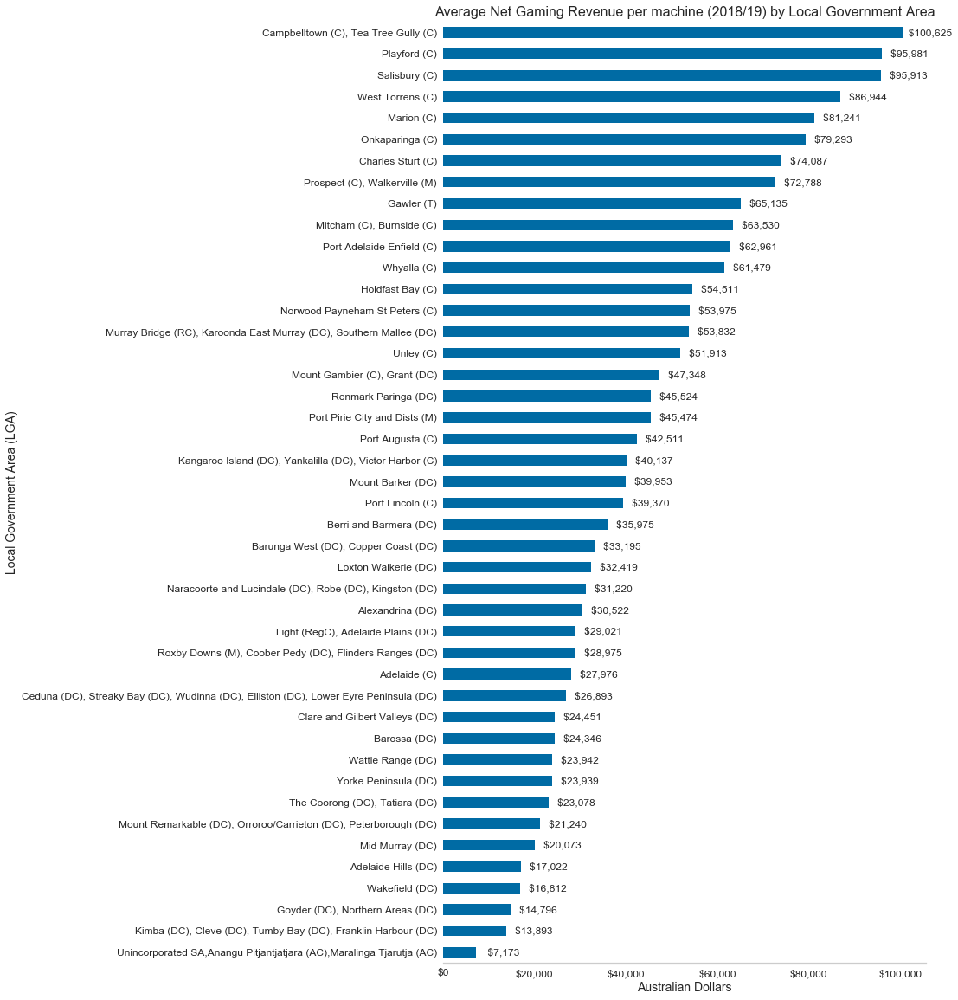

In [44]:

# plt.style.use('seaborn-deep')    
plt.style.use('tableau-colorblind10') 

ax = gaming_revenue_group_df.set_index('LgaGroup')['AvgNgrPerMachine'].sort_values().plot(kind='barh', grid=False, figsize=(10,20), fontsize=12);
ax.set_alpha(0.8)
ax.set_title("Average Net Gaming Revenue per machine (2018/19) by Local Government Area", fontsize=16)
ax.set_xlabel("Australian Dollars", fontsize=14)
ax.set_ylabel("Local Government Area (LGA)", fontsize=14)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(False)

formatter = ticker.StrMethodFormatter('${x:,.0f}')
ax.xaxis.set_major_formatter(formatter)

# add bar labels
for rect in ax.patches:
    label = '${:,.0f}'.format(rect.get_width())
    ax.text(rect.get_width(), rect.get_y() + rect.get_height() / 2., label.rjust(10, ' '), ha="left", va="center", fontsize=12)
    
plt.show()


### 5.4 Barchart: Average Net Gaming Revenue per venue (2018/19) by Local Government Area
Visualize Average Net Gaming Revenue per venue (2018/19) by Local Government Area

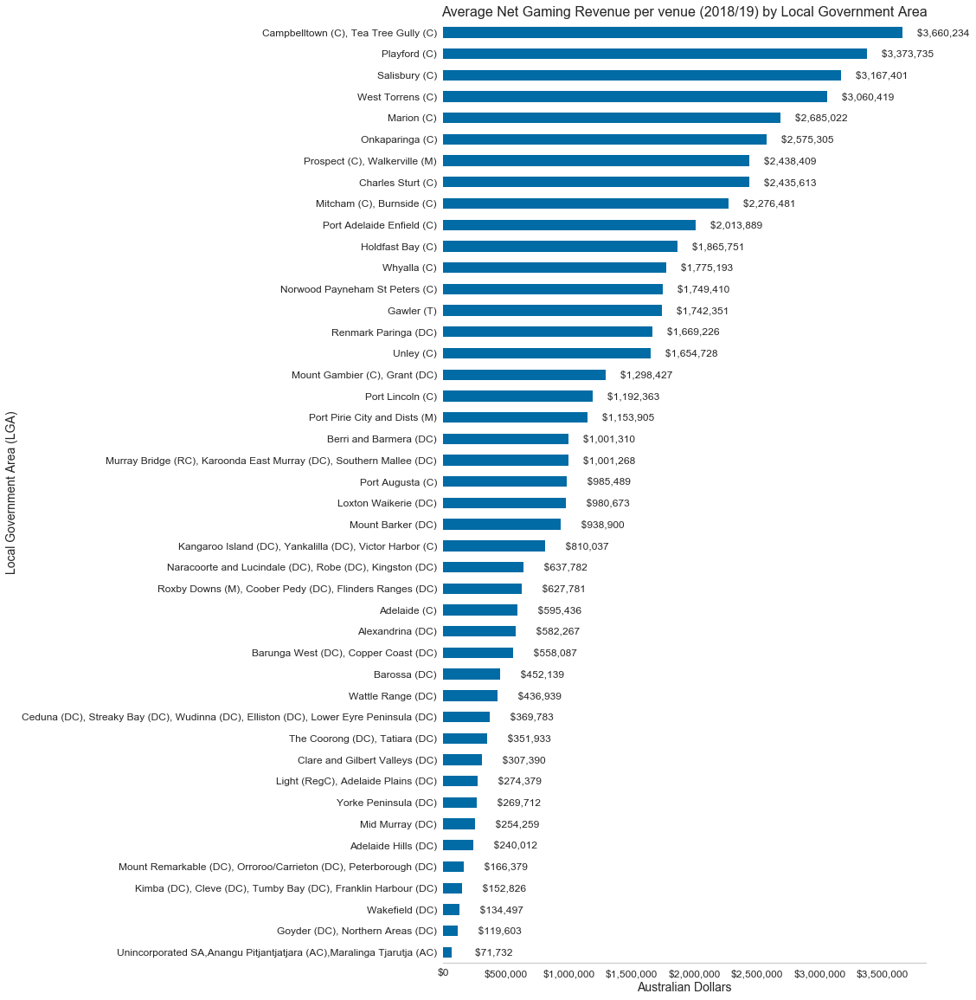

In [45]:

# plt.style.use('seaborn-deep')    
plt.style.use('tableau-colorblind10') 

ax = gaming_revenue_group_df.set_index('LgaGroup')['AverageNgrPerVenue'].sort_values().plot(kind='barh', grid=False, figsize=(10,20), fontsize=12);
ax.set_alpha(0.8)
ax.set_title("Average Net Gaming Revenue per venue (2018/19) by Local Government Area", fontsize=16)
ax.set_xlabel("Australian Dollars", fontsize=14)
ax.set_ylabel("Local Government Area (LGA)", fontsize=14)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(False)

formatter = ticker.StrMethodFormatter('${x:,.0f}')
ax.xaxis.set_major_formatter(formatter)

# add bar labels
for rect in ax.patches:
    label = '${:,.0f}'.format(rect.get_width())
    ax.text(rect.get_width(), rect.get_y() + rect.get_height() / 2., label.rjust(15, ' '), ha="left", va="center", fontsize=12)
    
plt.show()


### 5.5 Barchart: Population by City in Local Government Area (Campbelltown / Tea Tree Gully)
Visualize Population by City

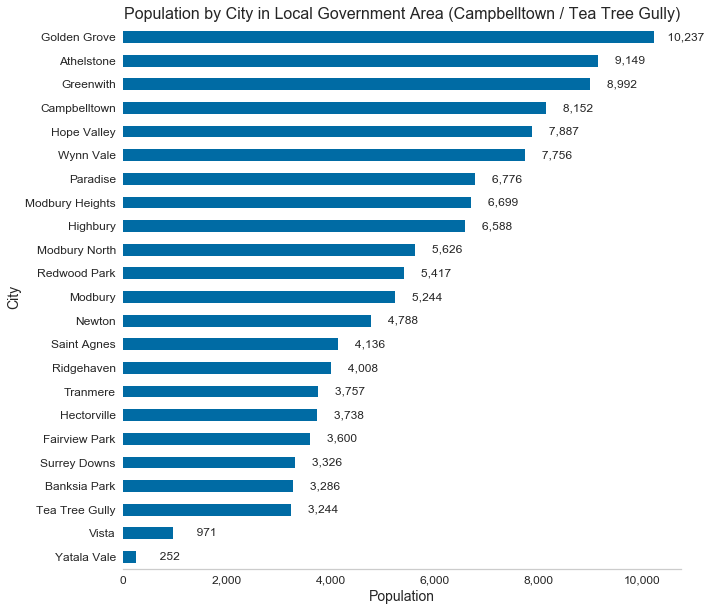

In [46]:
# plt.style.use('seaborn-deep')    
plt.style.use('tableau-colorblind10') 

ax = top_ngr_citycode_df.set_index('City')['People'].sort_values().plot(kind='barh', grid=False, figsize=(10,10), fontsize=12);
ax.set_alpha(0.8)
ax.set_title("Population by City in Local Government Area (Campbelltown / Tea Tree Gully)", fontsize=16)
ax.set_xlabel("Population", fontsize=14)
ax.set_ylabel("City", fontsize=14)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(False)

formatter = ticker.StrMethodFormatter('{x:,.0f}')
ax.xaxis.set_major_formatter(formatter)

# add bar labels
for rect in ax.patches:
    label = '{:,.0f}'.format(rect.get_width())
    ax.text(rect.get_width(), rect.get_y() + rect.get_height() / 2., label.rjust(10, ' '), ha="left", va="center", fontsize=12)
    
plt.show()


### 5.6 Choropleth: City, Hotel, Shopping Mall, Foursquare search radius and Traffic Volume

In [47]:
# load city shapefile
gdf = geopandas.read_file(GOV_CITY_SHAPEFILE_FILE)
gdf.suburb.replace(to_replace = "ST KILDA", value ="SAINT KILDA", inplace=True)
gdf.suburb.replace(to_replace = "ST AGNES", value ="SAINT AGNES", inplace=True)
gdf['suburb_title'] = gdf['suburb'].str.title()
    
# merge with top ngr by city on city
top_ngr_city_df = gdf.merge(top_ngr_citycode_df, left_on=['suburb_title'], right_on = ['City'], how='inner')

# Load trafic shapefile
tdf = geopandas.read_file(GOV_TRAFFIC_SHAPEFILE_FILE)



# --------------------------------------------------------------------------------------
# Group0 - City choropleth colormap
# --------------------------------------------------------------------------------------

# add colorscale to map so that it appears as the legend
map1 = folium.Map(location=[-34.829961, 138.710297],tiles="OpenStreetMap",zoom_start=12)

# legend
group0 = folium.FeatureGroup(name='<span style=<p><font color="purple">City Choropleth</font></p></span>')

## add colorscale to map so that it appears as the legend
colormap0 = branca.colormap.StepColormap(
    colors = ['#FFF8C3','#D4F9A9','#91F493','#79EEBE','#63D5E9','#4D79E3','#6538DE','#BA24D8','blue','red'],
    index = None,
    vmin = top_ngr_city_df.People.min(),
    vmax = top_ngr_city_df.People.max()
)
colormap0.caption="Persons count based on place of usual residence on Census night"
colormap0.add_to(map1)

popup0=GeoJsonPopup(
    fields=["City","LgaName","PostalCode","People", "MedianAge", "HouseholdIncome","Dwellings"],
    aliases=["City:", "Local Government Area:", "PostCode:", "Population:", "Median Age:", "Household Income:", "Dwellings:"],
    localize=True,
    sticky=False,
    labels=True,
)

folium.GeoJson(data=top_ngr_city_df, name='City', smooth_factor=2, control = True, overlay = True, popup=popup0,
               style_function=lambda x: {'color':'#000', 'weight':0.35, 'fillOpacity':0.5, 'fillColor': colormap0(x['properties']['People'])}
              ).add_to(group0)

group0.add_to(map1)



# --------------------------------------------------------------------------------------
# Group1 - Hotel Locations
# --------------------------------------------------------------------------------------

# legend
group1 = folium.FeatureGroup(name='<span style=<p><font color="red">Hotel Locations</font></p></span>')

# Group0 - Enumerate hotel dataframe
for lat,lng, premises, address, egm_count, lga_name, population, avg_tax_income, rank_tax_income in zip(hotel_df['Latitude'],
                                                                                                        hotel_df['Longitude'],
                                                                                                        hotel_df['PremisesName'],
                                                                                                        hotel_df['Address'],
                                                                                                        hotel_df['MachineCount'],
                                                                                                        hotel_df['LgaName'],
                                                                                                        hotel_df['PostalCodePopulation'],
                                                                                                        hotel_df['PostalCodeAvgTaxableIncome'],
                                                                                                        hotel_df['PostalCodeRankTaxableIncome']):
               
    html=("""<table class="tftable" border="0"><col width="150"><col width="350">
             <tr><td>Premises Name</td><td>{}</td></tr>
             <tr><td>Address</td><td>{}</td></tr>
             <tr><td>Machines</td><td>{:,d}</td></tr>
             <tr><td>LGA Name</td><td>{}</td></tr>
             <tr><td>Postcode Population</td><td>{:,d}</td></tr>
             <tr><td>Postcode Avg Income</td><td>${:,.0f}</td></tr>
             <tr><td>Postcode Income Rank</td><td>{:,d}</td></tr>
             </table>"""
          ).format(str(premises),
                   str(address),
                   int(egm_count),
                   str(lga_name),
                   int(population),
                   float(avg_tax_income),
                   int(rank_tax_income))        
        
    label = folium.Popup(html, max_width=500,min_width=500)
  
    # Group0  - Hotel Marker
    folium.CircleMarker([lat,lng], popup=label, color='red', fill=True, fill_opacity=1.0, radius=5).add_to(group1)
    group1.add_to(map1)

    
# --------------------------------------------------------------------------------------
# Group2 - Shopping Mall Locations
# --------------------------------------------------------------------------------------

# legend
group2 = folium.FeatureGroup(name='<span style=<p><font color="blue">Shopping Mall Locations</font></p></span>')

# Group2 - Enumerate hotel dataframe
for lat,lng, premises, address in zip(shopping_centre_df['Latitude'],
                                      shopping_centre_df['Longitude'],
                                      shopping_centre_df['Premises'],
                                      shopping_centre_df['Address']):
               
    html=("""<table class="tftable" border="0"><col width="120"><col width="300">
             <tr><td>Premises Name</td><td>{}</td></tr>
             <tr><td>Address</td><td>{}</td></tr>
             </table>"""
          ).format(str(premises),
                   str(address))        
        
    label = folium.Popup(html, max_width=400,min_width=400)
  
    # Group2  - Shopping Mall Marker
    folium.CircleMarker([lat,lng], popup=label, color='blue', fill=True, fill_opacity=1.0, radius=5).add_to(group2)
    group2.add_to(map1)
    
    
# --------------------------------------------------------------------------------------
# Group3 - Foursquare Venue Explore Search Area
# --------------------------------------------------------------------------------------

# legend
group3 = folium.FeatureGroup(name='<span style=<p><font color="#008080">Foursquare Search Area</font></p></span>')
    
# Group3 - Foursquare Venue Explore Search Radius
for lat, lng, city in zip(foursquare_venue_explore_df['Latitude'], foursquare_venue_explore_df['Longitude'],foursquare_venue_explore_df['City']):
    
    #Group3 - Circle
    folium.Circle(location=[lat,lng], fill=True, fill_opacity=0.02, fill_color='#008080', weight=1, color="#008080", radius=FOURSQUARE_SEARCH_RADIUS).add_to(group3)
    group3.add_to(map1)
    

# --------------------------------------------------------------------------------------
# Group4 - Traffic Volume choropleth colormap
# --------------------------------------------------------------------------------------

# legend
group4 = folium.FeatureGroup(name='<span style=<p><font color="green">Traffic Volume Estimates</font></p></span>')

tooltip=GeoJsonTooltip(
    fields=["road_no","tesecn_vol","cv_percent","number_cvs","class3to5","class6to9","class10","class11"],
    aliases=["Road No:","Total Traffic Volume:","Commercial Vehicle %:","Commercial Vehicle Volume:","2 to 4 Axle Truck %:","Articulated Vehicle %:","B Double %:","Double Road Train %:"],
    localize=True,
    sticky=False,
    labels=True,
)

folium.GeoJson(data=tdf, name='Traffic', smooth_factor=2, control = True, overlay = True, tooltip=tooltip,
               style_function=lambda x: {'color':'green', 'weight':3.0, 'lineOpacity':1.0,'fillOpacity':1.2, 'fillColor':'green'}
               ).add_to(group4)

group4.add_to(map1)

  
    
    
# --------------------------------------------------------------------------------------
# display map
# --------------------------------------------------------------------------------------
folium.map.LayerControl('topleft', collapsed=False).add_to(map1)
clear_output()
display(map1)


### 5.7 K-Means Cluster Analysis Of Cities by Foursquare Category
Conduct K-means clustering to group the cities by category using Foursquare data.<br>
pandas function pd.get_dummies creates a new dataframe which consists of zeros and ones for each 'CategoryName'

In [48]:
# One hot encoding
df = pd.get_dummies(foursquare_venue_explore_df[['CategoryName']], prefix="", prefix_sep="")

# Add City back to dataframe
df.insert(0, 'City', foursquare_venue_explore_df['City'])

# Group rows by city and take the mean of frequency of each venue category
foursquare_venue_one_shot_grouped_df = df.groupby('City').mean().reset_index()

<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [49]:
foursquare_venue_one_shot_grouped_df.to_csv(DATA_FOLDER + '_foursquare_venue_one_shot_grouped_df.csv')
print("foursquare_venue_one_shot_grouped_df shape is " , foursquare_venue_one_shot_grouped_df.shape)
foursquare_venue_one_shot_grouped_df.head(40)

foursquare_venue_one_shot_grouped_df shape is  (23, 274)


,City,Accessories Store,American Restaurant,Aquarium,Arcade,Art Gallery,Arts & Crafts Store,Asian Restaurant,Assisted Living,Athletics & Sports,Australian Restaurant,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bakery,Bank,Bar,Basketball Stadium,Beach,Bed & Breakfast,Betting Shop,Big Box Store,Bike Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Cafe,Camera Store,Campground,Candy Store,Car Wash,Casino,Cemetery,Cheese Shop,Child Care Service,Chinese Restaurant,Chiropractor,Church,City Hall,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College & University,College Academic Building,College Administrative Building,College Arts Building,College Auditorium,College Classroom,College Communications Building,College Library,College Technology Building,Comedy Club,Community Center,Community College,Concert Hall,Convenience Store,Convention Center,Cosmetics Shop,Coworking Space,Credit Union,Creperie,Cupcake Shop,Daycare,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Doctor's Office,Dog Run,Donut Shop,Dumpling Restaurant,Electronics Store,Elementary School,Event Space,Factory,Farm,Farmers Market,Fast Food Restaurant,Field,Financial or Legal Service,Fire Station,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop,Food Court,Food Truck,Football Stadium,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Funeral Home,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,General College & University,General Entertainment,General Travel,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Government Building,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Halal Restaurant,Hardware Store,Health & Beauty Service,Health Food Store,High School,History Museum,Hobby Shop,Hookah Bar,Hospital,Hot Dog Joint,Hotel Bar,Housing Development,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Kingdom Hall,Korean Restaurant,Laboratory,Lake,Laundry Service,Law School,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lottery Retailer,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Medical Center,Medical Lab,Medical Supply Store,Meeting Room,Men's Store,Mexican Restaurant,Middle School,Military Base,Miscellaneous Shop,Mobile Phone Shop,Movie Theater,Moving Target,Multiplex,Music Venue,Nail Salon,Nature Preserve,Newsstand,Nightlife Spot,Non-Profit,Noodle House,Nursery School,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Outdoor Supply Store,Paper / Office Supplies Store,Park,Parking,Pawn Shop,Performing Arts Venue,Pet Store,Pharmacy,Photography Lab,Piano Bar,Pizza Place,Playground,Plaza,Police Station,Pool,Post Office,Preschool,Professional & Other Places,Pub,Public Art,Racetrack,Real Estate Office,Record Shop,Recycling Facility,Rehab Center,Residential Building (Apartment / Condo),Restaurant,River,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shoe Repair,Shoe Store,Shopping Mall,Shopping Plaza,Skate Park,Ski Area,Smoke Shop,Snack Place,Soccer Field,Social Club,Southern / Soul Food Restaurant,Spa,Spiritual Center,Sporting Goods Shop,Sports Bar,Sports Club,Stables,Steakhouse,Strip Club,Student Center,Supermarket,Surf Spot,Sushi Restaurant,Swim School,Taco Place,Tattoo Parlor,Tech Startup,Temple,Tennis Court,Thai Restaurant,Theater,Thrift / Vintage Store,Tourist Information Center,Toy / Game Store,Trade School,Trail,Turkish Restaurant,Vegetarian / Vegan Restaurant,Veterinarian,Video Game Store,Video Store,Vietnamese Restaurant,Wine Bar,Winery,Women's Store,Yoga Studio
0,Athelstone,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.018182

In [50]:
# set number of clusters and verify
kclusters2 = 5
pp_clustering2 = foursquare_venue_one_shot_grouped_df.drop(['City'], 1)

# run k-means clustering
kmeans2 = KMeans(n_clusters=kclusters2, random_state=0).fit(pp_clustering2)

### 5.8 KElbowVisualizer: The Optimal K-Cluster with Elbow Method

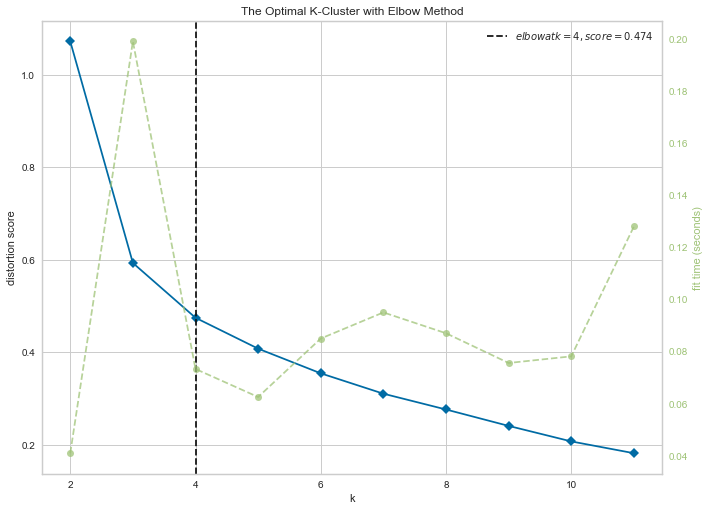

In [51]:
model = KMeans()
titleKElbow = "The Optimal K-Cluster with Elbow Method"
visualizer = KElbowVisualizer(model, k=(2,12), timings=True,title = titleKElbow, size=(800, 600))
visualizer.fit(pp_clustering2)
visualizer.show()  

### 5.9 Top Ten Most Common Venues by City

In [52]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    return row_categories_sorted.index.values[0:num_top_venues]

In [53]:
num_top_venues = 10
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['City']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
city_venues_sorted_df = pd.DataFrame(columns=columns)
city_venues_sorted_df['City'] = foursquare_venue_one_shot_grouped_df['City']

for ind in np.arange(foursquare_venue_one_shot_grouped_df.shape[0]):
    city_venues_sorted_df.iloc[ind, 1:] = return_most_common_venues(foursquare_venue_one_shot_grouped_df.iloc[ind, :], num_top_venues)

In [54]:
# Insert ClusterLabel and merge with city_venues_clustered_df
city_venues_sorted_df.insert(1, 'ClusterLabel', kmeans2.labels_)
city_venues_sorted_df.insert(2, 'ClusterDescription', '')

# Iterate over dataframe and update
for index, row in city_venues_sorted_df.iterrows():
    cluster=city_venues_sorted_df.at[index, 'ClusterLabel']
    if cluster==0:
        city_venues_sorted_df.at[index, 'ClusterDescription'] = 'Cluster 0: Quiet Suburban'
    elif cluster==1:
        city_venues_sorted_df.at[index, 'ClusterDescription'] = 'Cluster 1: Rural'
    elif cluster==2:
        city_venues_sorted_df.at[index, 'ClusterDescription'] = 'Cluster 2: Recreation Park'
    elif cluster==3:
        city_venues_sorted_df.at[index, 'ClusterDescription'] = 'Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)'
    elif cluster==4:
        city_venues_sorted_df.at[index, 'ClusterDescription'] = 'Cluster 4: Recreational Area (Golfcourse, Gyms, Parks)'

# Merge
city_venues_clustered_df = city_venues_sorted_df.merge(top_ngr_citycode_df, left_on=['City'], right_on = ['City'], how='inner')


<div class="alert alert-block alert-success">
<b>Check Dataframe: </b>Dataframe saved to comma delimited file, open in Excel and verify all columns populated
</div>

In [55]:
city_venues_clustered_df.to_csv(DATA_FOLDER + '_city_venues_clustered_df.csv')
print("city_venues_clustered_df shape is " , city_venues_clustered_df.shape)
city_venues_clustered_df.head(100)

city_venues_clustered_df shape is  (23, 43)


,City,ClusterLabel,ClusterDescription,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,MeshBlockCode,CityCode,StateCode,State,LgaCode,LgaName,Key,LgaGroup,VenueCount,EgmCount,TotalNgr,TotalNgrPerAdult,MachinesPer1000Adult,AvgNgrPerMachine,AggregateNgrPerLgaStr,AverageNgrPerVenueStr,TotalNgrPerAdultStr,AvgNgrPerMachineStr,RankTotalNgr,RankTotalNgrPerAdult,RankEgmsPer1000Adult,RankAvgNgrPerMachine,Address,PostalCode,Latitude,Longitude,People,MedianAge,HouseholdIncome,Dwellings
0,Athelstone,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Gas Station,Church,Pizza Place,Bus Station,Liquor Store,Cemetery,Playground,Trail,Soccer Field,Gym,40023510000,40048,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Athelstone SA 5076, Australia",5076,-34.870000,138.703000,9149.0,43,"1,634","3,327"
1,Banksia Park,4,"Cluster 4: Recreational Area (Golfcourse, Gyms, Parks)",Middle School,Athletics & Sports,Bus Station,Football Stadium,Church,Salon / Barbershop,Public Art,Playground,Daycare,Coworking Space,40184040000,40069,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Banksia Park SA 5091, Australia",5091,-34.809082,138.731693,3286.0,40,"1,492","1,179"
2,Campbelltown,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Pizza Place,Salon / Barbershop,Office,Bakery,Grocery Store,Bowling Alley,Housing Development,Doctor's Office,Miscellaneous Shop,Pharmacy,40027041000,40211,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Campbelltown SA 5074, Australia",5074,-34.878000,138.663000,8152.0,41,"1,040","3,221"
3,Fairview Park,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Park,Bus Station,Gas Station,Butcher,Trail,Playground,Bus Line,Dog Run,Tennis Court,Pharmacy,40184140000,40424,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Fairview Park SA 5126, Australia",5126,-34.799901,138.731693,3600.0,40,"1,525","1,319"
4,Golden Grove,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Miscellaneous Shop,Salon / Barbershop,Cafe,Bus Station,Bank,Gas Station,Asian Restaurant,Automotive Shop,Field,Office,40184101000,40511,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Golden Grove SA 5125, Australia",5125,-34.783889,138.706111,10237.0,42,"1,519","3,763"
5,Greenwith,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Playground,Italian Restaurant,Pizza Place,Medical Center,Building,Liquor Store,Clothing Store,Fish & Chips Shop,College & University,Dessert Shop,40185520000,40532,4,South Australia,47700,Tea Tree Gully (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",$367,"$100,625",5,27,42,1,"Greenwith SA 5125, Australia",5125,-34.766000,138.715000,8992.0,38,"1,622","3,224"
6,Hectorville,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Deli / Bodega,Pharmacy,Electronics Store,College Academic Building,Liquor Store,Supermarket,Furniture / Home Store,Doctor's Office,Dog Run,Church,40027190000,40576,4,South Australia,40910,Campbelltown (C),7,"Campbelltown (C), Tea Tree Gully (C)",12,438,43922.81,366.6,3.65,100625.0,"$43,922,813","$3,660,234",

### 5.10 Choropleth: Visualize Clusters by City

In [56]:
# load city shapefile
gdf = geopandas.read_file(GOV_CITY_SHAPEFILE_FILE)
gdf.suburb.replace(to_replace = "ST KILDA", value ="SAINT KILDA", inplace=True)
gdf.suburb.replace(to_replace = "ST AGNES", value ="SAINT AGNES", inplace=True)
gdf['suburb_title'] = gdf['suburb'].str.title()
    
# merge with top ngr by city on city
clustered_df = gdf.merge(city_venues_clustered_df, left_on=['suburb_title'], right_on = ['City'], how='inner')


# --------------------------------------------------------------------------------------
# Group0 - City choropleth colormap
# --------------------------------------------------------------------------------------

# add colorscale to map so that it appears as the legend
map1 = folium.Map(location=[-34.829961, 138.710297],tiles="OpenStreetMap",zoom_start=12)

# legend
group0 = folium.FeatureGroup(name='<span style=<p><font color="purple">Cluster Choropleth</font></p></span>')

## add colorscale to map so that it appears as the legend
colormap0 = branca.colormap.StepColormap(
    colors = ['#79EEBE','#63D5E9','#4D79E3','#6538DE','#BA24D8'],
    index = None,
    vmin = clustered_df.ClusterLabel.min(),
    vmax = clustered_df.ClusterLabel.max()
)
colormap0.caption="Cluster Type"
colormap0.add_to(map1)

popup0=GeoJsonPopup(
    fields=["City","ClusterDescription","LgaName","PostalCode","People", "MedianAge", "HouseholdIncome","Dwellings"],
    aliases=["City:", "Cluster Type","Local Government Area:", "PostCode:", "Population:", "Median Age:", "Household Income:", "Dwellings:"],
    localize=True,
    sticky=False,
    labels=True,
    max_width=600,
    min_width=300
)

folium.GeoJson(data=clustered_df, name='City', smooth_factor=2, control = True, overlay = True, popup=popup0,
               style_function=lambda x: {'color':'#000', 'weight':0.35, 'fillOpacity':0.5, 'fillColor': colormap0(x['properties']['ClusterLabel'])}
              ).add_to(group0)

group0.add_to(map1)



# --------------------------------------------------------------------------------------
# Group1 - Hotel Locations
# --------------------------------------------------------------------------------------

# legend
group1 = folium.FeatureGroup(name='<span style=<p><font color="red">Hotel Locations</font></p></span>')

# Group0 - Enumerate hotel dataframe
for lat,lng, premises, address, egm_count, lga_name, population, avg_tax_income, rank_tax_income in zip(hotel_df['Latitude'],
                                                                                                        hotel_df['Longitude'],
                                                                                                        hotel_df['PremisesName'],
                                                                                                        hotel_df['Address'],
                                                                                                        hotel_df['MachineCount'],
                                                                                                        hotel_df['LgaName'],
                                                                                                        hotel_df['PostalCodePopulation'],
                                                                                                        hotel_df['PostalCodeAvgTaxableIncome'],
                                                                                                        hotel_df['PostalCodeRankTaxableIncome']):
               
    html=("""<table class="tftable" border="0"><col width="150"><col width="350">
             <tr><td>Premises Name</td><td>{}</td></tr>
             <tr><td>Address</td><td>{}</td></tr>
             <tr><td>Machines</td><td>{:,d}</td></tr>
             <tr><td>LGA Name</td><td>{}</td></tr>
             <tr><td>Postcode Population</td><td>{:,d}</td></tr>
             <tr><td>Postcode Avg Income</td><td>${:,.0f}</td></tr>
             <tr><td>Postcode Income Rank</td><td>{:,d}</td></tr>
             </table>"""
          ).format(str(premises),
                   str(address),
                   int(egm_count),
                   str(lga_name),
                   int(population),
                   float(avg_tax_income),
                   int(rank_tax_income))        
        
    label = folium.Popup(html, max_width=500,min_width=500)
  
    # Group0  - Hotel Marker
    folium.CircleMarker([lat,lng], popup=label, color='red', fill=True, fill_opacity=1.0, radius=5).add_to(group1)
    group1.add_to(map1)

    
# --------------------------------------------------------------------------------------
# Group2 - Shopping Mall Locations
# --------------------------------------------------------------------------------------

# legend
group2 = folium.FeatureGroup(name='<span style=<p><font color="blue">Shopping Mall Locations</font></p></span>')

# Group2 - Enumerate hotel dataframe
for lat,lng, premises, address in zip(shopping_centre_df['Latitude'],
                                      shopping_centre_df['Longitude'],
                                      shopping_centre_df['Premises'],
                                      shopping_centre_df['Address']):
               
    html=("""<table class="tftable" border="0"><col width="120"><col width="300">
             <tr><td>Premises Name</td><td>{}</td></tr>
             <tr><td>Address</td><td>{}</td></tr>
             </table>"""
          ).format(str(premises),
                   str(address))        
        
    label = folium.Popup(html, max_width=400,min_width=400)
  
    # Group2  - Shopping Mall Marker
    folium.CircleMarker([lat,lng], popup=label, color='blue', fill=True, fill_opacity=1.0, radius=5).add_to(group2)
    group2.add_to(map1)
    
    
    
# --------------------------------------------------------------------------------------
# display map
# --------------------------------------------------------------------------------------
folium.map.LayerControl('topleft', collapsed=False).add_to(map1)
clear_output()
display(map1)


### 5.11 Examining distributional characteristics of clusters
K-Means Clustering is an unsupervised machine learning algorithm.<br>
In contrast to traditional supervised machine learning algorithms, K-Means attempts to classify data without having first been trained with labeled data.<br>
Once the algorithm has been run and the groups are defined, any new data can be easily assigned to the most relevant group.

In [57]:
result = city_venues_clustered_df.loc[city_venues_clustered_df['ClusterLabel'] >= 0, city_venues_clustered_df.columns[list(range(0, 13))]]
result.sort_values(by=['City'], inplace=True)
result.head(30)                             

,City,ClusterLabel,ClusterDescription,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Athelstone,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Gas Station,Church,Pizza Place,Bus Station,Liquor Store,Cemetery,Playground,Trail,Soccer Field,Gym
1,Banksia Park,4,"Cluster 4: Recreational Area (Golfcourse, Gyms, Parks)",Middle School,Athletics & Sports,Bus Station,Football Stadium,Church,Salon / Barbershop,Public Art,Playground,Daycare,Coworking Space
2,Campbelltown,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Pizza Place,Salon / Barbershop,Office,Bakery,Grocery Store,Bowling Alley,Housing Development,Doctor's Office,Miscellaneous Shop,Pharmacy
3,Fairview Park,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Park,Bus Station,Gas Station,Butcher,Trail,Playground,Bus Line,Dog Run,Tennis Court,Pharmacy
4,Golden Grove,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Miscellaneous Shop,Salon / Barbershop,Cafe,Bus Station,Bank,Gas Station,Asian Restaurant,Automotive Shop,Field,Office
5,Greenwith,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Playground,Italian Restaurant,Pizza Place,Medical Center,Building,Liquor Store,Clothing Store,Fish & Chips Shop,College & University,Dessert Shop
6,Hectorville,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Deli / Bodega,Pharmacy,Electronics Store,College Academic Building,Liquor Store,Supermarket,Furniture / Home Store,Doctor's Office,Dog Run,Church
7,Highbury,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Bus Station,Playground,Lake,Doctor's Office,Cafe,Chinese Restaurant,Pub,Post Office,College Technology Building,Office
8,Hope Valley,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Park,Pizza Place,Church,Bus Station,Bakery,Playground,Pub,Pharmacy,Post Office,Piano Bar
9,Modbury,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Cafe,Salon / Barbershop,Women's Store,Bank,Jewelry Store,Cosmetics Shop,Department Store,Electronics Store,Doctor's Office,Optical Shop


### 5.12 Cluster 0: Quiet Suburban
High frequency bus services, because of the area's distance from major business districts<br>
Small supermarket and several smaller speciality shops

In [58]:
result = city_venues_clustered_df.loc[city_venues_clustered_df['ClusterLabel'] == 0, city_venues_clustered_df.columns[list(range(0, 13))]]
result.sort_values(by=['1st Most Common Venue', '2nd Most Common Venue'], inplace=True)
result.head(30)                             

,City,ClusterLabel,ClusterDescription,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
10,Modbury Heights,0,Cluster 0: Quiet Suburban,Bus Line,Playground,Park,Bus Station,Snack Place,College Arts Building,Dog Run,Doctor's Office,Gaming Cafe,Shopping Mall
17,Surrey Downs,0,Cluster 0: Quiet Suburban,Bus Line,Post Office,Supermarket,Soccer Field,Bus Station,Cafe,School,Restaurant,Residential Building (Apartment / Condo),Coffee Shop


### 5.13 Cluster 1: Rural
Yatala Vale is an outer northeastern rural suburb of Adelaide, South Australia

In [59]:
result = city_venues_clustered_df.loc[city_venues_clustered_df['ClusterLabel'] == 1, city_venues_clustered_df.columns[list(range(0, 13))]]
result.sort_values(by=['1st Most Common Venue', '2nd Most Common Venue'], inplace=True)
result.head(30)                             

,City,ClusterLabel,ClusterDescription,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
22,Yatala Vale,1,Cluster 1: Rural,Beach,Garden Center,Farmers Market,Electronics Store,Elementary School,Event Space,Factory,Farm,Yoga Studio,Dumpling Restaurant


### 5.14 Cluster 2: Recreation Park
The eastern three-quarters of the suburb is part of the Anstey Hill Recreation Park

In [60]:
result = city_venues_clustered_df.loc[city_venues_clustered_df['ClusterLabel'] == 2, city_venues_clustered_df.columns[list(range(0, 13))]]
result.sort_values(by=['1st Most Common Venue', '2nd Most Common Venue'], inplace=True)
result.head(30)                             

,City,ClusterLabel,ClusterDescription,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
20,Vista,2,Cluster 2: Recreation Park,Comedy Club,School,Yoga Studio,Farmers Market,Electronics Store,Elementary School,Event Space,Factory,Farm,Fast Food Restaurant


### 5.15 Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)
Westfield Tea Tree Plaza is a large shopping centre located in Modbury serving as a shopping hub for Adelaide's growing north eastern suburbs, it’s linked to the city by Adelaide's unique O-Bahn Busway, which terminates at the Tea Tree Plaza Interchange

In [61]:
result = city_venues_clustered_df.loc[city_venues_clustered_df['ClusterLabel'] == 3, city_venues_clustered_df.columns[list(range(0, 13))]]
result.sort_values(by=['1st Most Common Venue', '2nd Most Common Venue'], inplace=True)
result.head(30)                             

,City,ClusterLabel,ClusterDescription,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
16,Saint Agnes,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Automotive Shop,Factory,Shopping Mall,Salon / Barbershop,Pet Store,Bakery,Medical Center,Supermarket,Food & Drink Shop,Office
15,Ridgehaven,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Automotive Shop,Medical Center,Gas Station,Building,Shopping Mall,Arcade,Spa,Bus Line,Playground,Sports Club
12,Newton,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Bakery,Miscellaneous Shop,Shopping Mall,Office,Doctor's Office,Bank,Supermarket,Cafe,Bus Line,Post Office
7,Highbury,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Bus Station,Playground,Lake,Doctor's Office,Cafe,Chinese Restaurant,Pub,Post Office,College Technology Building,Office
9,Modbury,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Cafe,Salon / Barbershop,Women's Store,Bank,Jewelry Store,Cosmetics Shop,Department Store,Electronics Store,Doctor's Office,Optical Shop
11,Modbury North,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Church,Bus Line,Gas Station,Salon / Barbershop,Indian Restaurant,Event Space,Bookstore,Karaoke Bar,Post Office,Preschool
13,Paradise,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Church,School,Bus Stop,Park,Cosmetics Shop,Bus Station,Rock Club,College Academic Building,Sports Bar,Pub
6,Hectorville,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Deli / Bodega,Pharmacy,Electronics Store,College Academic Building,Liquor Store,Supermarket,Furniture / Home Store,Doctor's Office,Dog Run,Church
0,Athelstone,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Gas Station,Church,Pizza Place,Bus Station,Liquor Store,Cemetery,Playground,Trail,Soccer Field,Gym
19,Tranmere,3,"Cluster 3: Busy Area (Shopping Malls, Densely Populated, High Traffic Volume)",Korean Restaurant,Park,Lounge,Pharmacy,Pizza Place,Gym,Coffee Shop,Jewelry Store,Post Office,Sports Club


### 5.16 Cluster 4: Recreational Area (Golfcourse, Gyms, Parks)
Quiet Residential area with Playgrounds, sports facilities and parks

In [62]:
result = city_venues_clustered_df.loc[city_venues_clustered_df['ClusterLabel'] == 4, city_venues_clustered_df.columns[list(range(0, 13))]]
result.sort_values(by=['1st Most Common Venue', '2nd Most Common Venue'], inplace=True)
result.head(30)                             

,City,ClusterLabel,ClusterDescription,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Banksia Park,4,"Cluster 4: Recreational Area (Golfcourse, Gyms, Parks)",Middle School,Athletics & Sports,Bus Station,Football Stadium,Church,Salon / Barbershop,Public Art,Playground,Daycare,Coworking Space
